In [ ]:
from google.colab import drive
drive.mount('/content/drive')
PROJECT_DIR = "/content/drive/MyDrive/plant_leaf_compression"
!mkdir -p "$PROJECT_DIR"
%cd "$PROJECT_DIR"


Mounted at /content/drive
/content/drive/MyDrive/plant_leaf_compression


In [ ]:
!pip install -q torch torchvision torchaudio
!pip install -q albumentations opencv-python-headless pytorch-msssim lpips tqdm tensorflow-datasets


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 3.3 MB/s eta 0:00:00


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from math import log2, pi
device = "cuda" if torch.cuda.is_available() else "cpu"
import os
import time
import math
from torch.cuda.amp import autocast, GradScaler
from pytorch_msssim import ms_ssim
import lpips
from torchvision.utils import make_grid
import numpy as np

In [ ]:
!ls /content/drive/MyDrive/plant_leaf_compression


'archive(3).zip'   checkpoints	 final_model   plantvillage   PlantVillage


# DO NOT RUN THIS AGAIN AT ALL COST

In [ ]:
!apt install p7zip-full -y
!7z x "/content/drive/MyDrive/plant_leaf_compression/archive(3).zip" -o"/content/drive/MyDrive/plant_leaf_compression/"


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
p7zip-full is already the newest version (16.02+dfsg-8).
0 upgraded, 0 newly installed, 0 to remove and 41 not upgraded.

7-Zip [64] 16.02 : Copyright (c) 1999-2016 Igor Pavlov : 2016-05-21
p7zip Version 16.02 (locale=en_US.UTF-8,Utf16=on,HugeFiles=on,64 bits,2 CPUs AMD EPYC 7B12 (830F10),ASM,AES-NI)

Scanning the drive for archives:
  0M Scan /content/drive/MyDrive/plant_leaf_compression/                                                        1 file, 689512690 bytes (658 MiB)

Extracting archive: /content/drive/MyDrive/plant_leaf_compression/archive(3).zip
  9% 4096 Open               79% 32768 Open               --
Path = /content/drive/MyDrive/plant_leaf_compression/archive(3).zip
Type = zip
Physical Size = 689512690

  

# ***Run the import and pip then run from here***

In [ ]:
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split

# Define augmentations
train_tf = transforms.Compose([
    transforms.RandomResizedCrop(256, scale=(0.8,1.0)),
    transforms.RandomHorizontalFlip(),
    transforms.ColorJitter(brightness=0.2, contrast=0.2),
    transforms.ToTensor(),
])
val_tf = transforms.Compose([
    transforms.Resize((256,256)),
    transforms.ToTensor(),
])

# Load dataset
root_dir = "/content/drive/MyDrive/plant_leaf_compression/PlantVillage"
full_dataset = datasets.ImageFolder(root=root_dir, transform=train_tf)

# Split into train/val (90/10)
train_size = int(0.9 * len(full_dataset))
val_size = len(full_dataset) - train_size
train_dataset, val_dataset = random_split(full_dataset, [train_size, val_size])
val_dataset.dataset.transform = val_tf  # override transform

# Create loaders
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=False, num_workers=2)

print(f"Train samples: {len(train_dataset)}, Val samples: {len(val_dataset)}")


Train samples: 18574, Val samples: 2064


/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


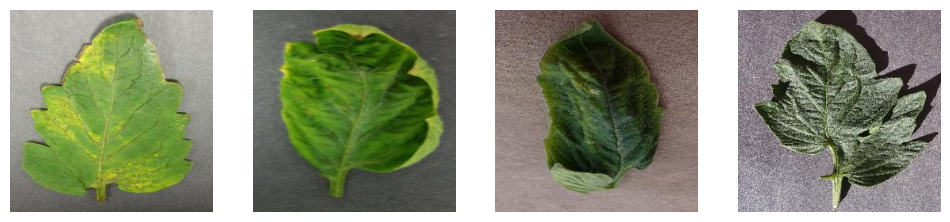

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

imgs, _ = next(iter(train_loader))
fig, axs = plt.subplots(1, 4, figsize=(12,4))
for i in range(4):
    axs[i].imshow(np.transpose(imgs[i].numpy(), (1,2,0)))
    axs[i].axis("off")
plt.show()


# Training of Autoencoder + Hyprior

In [ ]:
# === Lightweight autoencoder + hyperprior (PyTorch) ===
# -------------------------
# Basic building blocks
# -------------------------
class DWConv(nn.Module):
    """Depthwise separable conv: depthwise then pointwise"""
    def __init__(self, in_ch, out_ch, kernel=3, stride=1, padding=1):
        super().__init__()
        self.dw = nn.Conv2d(in_ch, in_ch, kernel, stride=stride, padding=padding, groups=in_ch, bias=False)
        self.pw = nn.Conv2d(in_ch, out_ch, 1, bias=True)
        self.act = nn.LeakyReLU(0.2, inplace=True)
    def forward(self, x):
        x = self.dw(x)
        x = self.pw(x)
        return self.act(x)

class ConvBlock(nn.Module):
    def __init__(self, in_ch, out_ch, stride=1, use_dw=True):
        super().__init__()
        if use_dw:
            self.conv = DWConv(in_ch, out_ch, stride=stride)
        else:
            self.conv = nn.Sequential(
                nn.Conv2d(in_ch, out_ch, 3, stride=stride, padding=1, bias=True),
                nn.LeakyReLU(0.2, inplace=True)
            )
    def forward(self, x):
        return self.conv(x)

In [ ]:
# -------------------------
# Analysis / Synthesis transforms
# -------------------------
class AnalysisTransform(nn.Module):
    def __init__(self, in_ch=3, channels=[32,64,96,128], latent_ch=96):
        super().__init__()
        layers = []
        cprev = in_ch
        for i,c in enumerate(channels):
            s = 2 if i>0 else 1  # downsample at subsequent blocks
            layers.append(ConvBlock(cprev, c, stride=s, use_dw=True))
            cprev = c
        layers.append(nn.Conv2d(cprev, latent_ch, 3, padding=1))
        self.net = nn.Sequential(*layers)
    def forward(self, x):
        return self.net(x)

class SynthesisTransform(nn.Module):
    def __init__(self, out_ch=3, channels=[128,96,64], latent_ch=96):
        """
        Decoder with 3 upsample stages to match encoder's 3 downsamples.
        For encoder channels=[32,64,96,128] we downsample at i>0 -> 3 downsamples.
        """
        super().__init__()
        layers = []
        cprev = latent_ch
        for c in channels:
            layers.append(nn.ConvTranspose2d(cprev, c, 4, stride=2, padding=1))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            cprev = c
        layers.append(nn.Conv2d(cprev, out_ch, 3, padding=1))
        self.net = nn.Sequential(*layers)

    def forward(self, y):
        return self.net(y)


In [ ]:
# -------------------------
# Hyperprior (scale predictor)
# -------------------------
class HyperEncoder(nn.Module):
    def __init__(self, in_ch, hidden=[64,64], z_ch=48):
        super().__init__()
        layers = []
        cprev = in_ch
        for c in hidden:
            layers.append(nn.Conv2d(cprev, c, 3, stride=2, padding=1))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            cprev = c
        layers.append(nn.Conv2d(cprev, z_ch, 3, padding=1))
        self.net = nn.Sequential(*layers)
    def forward(self, x):
        return self.net(x)

class HyperDecoder(nn.Module):
    def __init__(self, z_ch, out_ch, hidden=[64,64]):
        super().__init__()
        layers = []
        cprev = z_ch
        for c in hidden:
            layers.append(nn.ConvTranspose2d(cprev, c, 4, stride=2, padding=1))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            cprev = c
        layers.append(nn.Conv2d(cprev, out_ch, 3, padding=1))
        # we will ensure positive scale via softplus in forward
        self.net = nn.Sequential(*layers)
    def forward(self, z):
        return self.net(z)

In [ ]:
# -------------------------
# Autoencoder with hyperprior
# -------------------------
class AutoencoderWithHyperprior(nn.Module):
    def __init__(self, in_ch=3, channels=[32,64,96,128], latent_ch=96, z_ch=48):
        super().__init__()
        self.analysis = AnalysisTransform(in_ch=in_ch, channels=channels, latent_ch=latent_ch)
        self.synthesis = SynthesisTransform(out_ch=in_ch, channels=[128, 96, 64], latent_ch=latent_ch)
        self.hyper_enc = HyperEncoder(in_ch=latent_ch, hidden=[64,64], z_ch=z_ch)
        self.hyper_dec = HyperDecoder(z_ch=z_ch, out_ch=latent_ch, hidden=[64,64])
        # small constant to keep sigma > 0
        self.eps = 1e-6

    def quantize(self, y, training=True):
        if training:
            # additive uniform noise approximation (for gradient)
            noise = torch.empty_like(y).uniform_(-0.5, 0.5)
            return y + noise
        else:
            # inference: round
            return torch.round(y)

    def forward(self, x, training=True):
        # analysis
        y = self.analysis(x)               # latent (float)
        # hyperprior
        z = self.hyper_enc(torch.abs(y))   # encode magnitude -> z
        z_hat = self.quantize(z, training=training)
        sigma_map = self.hyper_dec(z_hat)  # predicted scale-like map (can be negative)
        # ensure positive scales: softplus
        sigma = F.softplus(sigma_map) + self.eps  # shape same as y

        # quantize y
        y_tilde = self.quantize(y, training=training)

        # synthesis
        x_hat = self.synthesis(y_tilde)

        # estimate rate (bits) from y_tilde under zero-mean Gaussian with predicted sigma
        # We approximate p(y) ~ N(0, sigma^2) (you can later model mean)
        # log prob per element: -0.5*log(2*pi) - log(sigma) - 0.5*(y/sigma)^2
        # bits = -sum(log2 p)
        # compute elementwise:
        with torch.no_grad():
            var = sigma**2
            log_prob = -0.5 * (torch.log(2*pi*var) + (y_tilde**2) / var)  # natural log
            # convert to bits:
            bits = -torch.sum(log_prob) / log2(torch.exp(torch.tensor(1.0)))  # ln -> log2
        # compute bpp (bits per pixel)
        _,_,H,W = x.shape
        bpp = bits / (x.shape[0] * H * W)

        return x_hat, y_tilde, z_hat, sigma, bpp

In [ ]:
# -------------------------
# Utilities
# -------------------------
def count_params(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [ ]:
# -------------------------
# Smoke test / instantiate
# -------------------------
if __name__ == "__main__":
    model = AutoencoderWithHyperprior().to(device)
    print("Model params:", count_params(model))
    # forward a dummy batch
    bs = 4
    img = torch.randn(bs, 3, 256, 256, device=device)
    model.eval()
    with torch.no_grad():
        xhat, y, zhat, sigma, bpp = model(img, training=False)
    print("Input:", img.shape, "Recon:", xhat.shape, "latent shape:", y.shape, "sigma shape:", sigma.shape)
    print("Estimated bpp (dummy):", float(bpp))
    assert xhat.shape == img.shape, f"Reconstruction size mismatch: {xhat.shape} != {img.shape}"
    print("Reconstruction size matches input. Ready for training smoke step.")


Model params: 917070
Input: torch.Size([4, 3, 256, 256]) Recon: torch.Size([4, 3, 256, 256]) latent shape: torch.Size([4, 96, 32, 32]) sigma shape: torch.Size([4, 96, 32, 32])
Estimated bpp (dummy): 0.5721378922462463
Reconstruction size matches input. Ready for training smoke step.


In [ ]:
def rate_distortion_loss(x, x_hat, R_bpp, lambda_rd=0.01,
                         w_mse=1.0, w_msssim=0.8, w_lpips=0.02, w_edge=0.5):
    # R_bpp is bits per pixel scalar/tensor
    # D: distortion terms
    mse = F.mse_loss(x_hat, x, reduction='mean')
    mss = 1.0 - ms_ssim(x_hat, x, data_range=1.0, size_average=True)  # ms-ssim -> 1 - ssim
    # lpips expects [-1,1]
    lpips_val = lpips_fn((x*2-1).clamp(-1,1), (x_hat*2-1).clamp(-1,1)).mean()
    # simple edge loss (Sobel) example (optional)
    def edge_loss(a, b):
        # very small illustrative sobel-like edge comparator (replace with proper operator if required)
        # convert to gray
        ga = a.mean(dim=1, keepdim=True)
        gb = b.mean(dim=1, keepdim=True)
        return F.mse_loss(ga, gb)
    edge = edge_loss(x, x_hat)
    D_total = w_mse * mse + w_msssim * mss + w_lpips * lpips_val + w_edge * edge
    R = R_bpp
    loss = lambda_rd * R + D_total
    logs = {"R_bpp": float(R), "D_total": float(D_total)}
    return loss, logs


# DONT RUN THIS

In [ ]:
# SINGLE-STEP TRAINING SMOKE TEST (forward + loss + backward)
import torch
from torch.cuda.amp import autocast, GradScaler

device = "cuda" if torch.cuda.is_available() else "cpu"
model = AutoencoderWithHyperprior().to(device)
opt = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-6)
scaler = GradScaler()

# get one batch from your real train_loader
imgs, _ = next(iter(train_loader))   # ensure train_loader exists
imgs = imgs.to(device)

model.train()
with autocast():
    x_hat, y_tilde, z_hat, sigma, bpp = model(imgs, training=True)
    total_loss, logs = rate_distortion_loss(imgs, x_hat, bpp,
                                           lambda_rd=0.01,
                                           w_mse=1.0, w_msssim=0.8, w_lpips=0.02, w_edge=0.5)

scaler.scale(total_loss).backward()
scaler.step(opt)
scaler.update()
opt.zero_grad()

print("Smoke training step done. Logs:", logs)


/tmp/ipython-input-1192407193.py:8: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()
/tmp/ipython-input-1192407193.py:15: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():


NameError: name 'lpips_fn' is not defined

# Training Loop

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
out_dir = "/content/drive/MyDrive/plant_leaf_compression/checkpoints"
os.makedirs(out_dir, exist_ok=True)

num_epochs = 10           # start small for pilot; increase later (50-150)
save_every = 1
batch_size = None         # use existing DataLoader batch size
lr = 1e-4
weight_decay = 1e-6
lambda_rd = 0.01          # RD tradeoff, tune
w_mse, w_msssim, w_lpips, w_edge = 1.0, 0.8, 0.02, 0.5

In [ ]:
# --- Models & helpers (re-use lpips model if created earlier) ---
lpips_fn = lpips.LPIPS(net='vgg').to(device)
lpips_fn.eval()
scaler = GradScaler()

# utility metrics
def psnr(x, x_hat, data_range=1.0):
    mse = F.mse_loss(x_hat, x, reduction='mean')
    return 10.0 * torch.log10(data_range**2 / mse)

Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.12/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth


100%|██████████| 528M/528M [00:03<00:00, 145MB/s]


Loading model from: /usr/local/lib/python3.12/dist-packages/lpips/weights/v0.1/vgg.pth


/tmp/ipython-input-4021212720.py:4: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = GradScaler()


In [ ]:
# load model (assumes AutoencoderWithHyperprior defined)
model = AutoencoderWithHyperprior().to(device)
print("Model params:", count_params(model))

opt = torch.optim.AdamW(model.parameters(), lr=lr, weight_decay=weight_decay)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(opt, T_max=num_epochs)

# optionally resume
start_epoch = 0
best_val_msssim = -1.0

Model params: 917070


In [ ]:
# quick function to run a validation epoch (compute avg metrics)
def validate_epoch(model, val_loader, n_val_images=None):
    model.eval()
    tot_bpp = 0.0
    tot_psnr = 0.0
    tot_msssim = 0.0
    tot_lpips = 0.0
    count = 0
    with torch.no_grad():
        for imgs, _ in val_loader:
            imgs = imgs.to(device)
            x_hat, y_tilde, z_hat, sigma, bpp = model(imgs, training=False)
            # metrics (batch-wise mean)
            tot_bpp += float(bpp.item()) * imgs.size(0)
            tot_psnr += float(psnr(imgs, x_hat).item()) * imgs.size(0)
            mss = ms_ssim(x_hat, imgs, data_range=1.0, size_average=True)
            tot_msssim += float(mss.item()) * imgs.size(0)
            # LPIPS expects [-1,1]
            lpips_val = lpips_fn((imgs*2-1).clamp(-1,1), (x_hat*2-1).clamp(-1,1)).mean().item()
            tot_lpips += lpips_val * imgs.size(0)
            count += imgs.size(0)
            # optional: limit validation samples for speed
            if n_val_images and count >= n_val_images:
                break
    return {
        "bpp": tot_bpp / count,
        "psnr": tot_psnr / count,
        "msssim": tot_msssim / count,
        "lpips": tot_lpips / count,
    }

# **MAIN TRAINING FUNCTION DO NOT RUN UNLESS TRAINING AGAIN**

In [ ]:
import time, os, torch, heapq
import numpy as np
from collections import deque
from tqdm import tqdm
from torch.amp import autocast

device_type = "cuda" if torch.cuda.is_available() else "cpu"

# --- EarlyStopping helper ---
class EarlyStopping:
    def __init__(self, patience=6, min_delta=1e-4, mode='min', restore_best=True, smoothing_window=3):
        assert mode in ('min','max')
        self.patience = patience
        self.min_delta = min_delta
        self.mode = mode
        self.restore_best = restore_best
        self.smoothing_window = smoothing_window

        self.best_score = None
        self.wait = 0
        self.best_ckpt_path = None

        # keep a deque for smoothing
        self._recent = deque(maxlen=smoothing_window)

    def _is_better(self, current, best):
        if best is None:
            return True
        if self.mode == 'min':
            return (best - current) > self.min_delta
        else:
            return (current - best) > self.min_delta

    def step(self, current_metric, ckpt_path=None):
        """
        current_metric: scalar (not tensor)
        ckpt_path: path to checkpoint file (will be saved as best if metric improves)
        returns: should_stop (bool)
        """
        # add to smoothing window
        self._recent.append(float(current_metric))
        smoothed = float(np.mean(self._recent))

        if self.best_score is None or self._is_better(smoothed, self.best_score):
            self.best_score = smoothed
            self.wait = 0
            if ckpt_path:
                self.best_ckpt_path = ckpt_path
        else:
            self.wait += 1

        # debug
        # print(f"[EarlyStopping] smoothed={smoothed:.6f}, best={self.best_score:.6f}, wait={self.wait}/{self.patience}")
        return self.wait >= self.patience

    def load_best(self, model, optimizer=None, map_location=None):
        if self.restore_best and self.best_ckpt_path:
            map_location = map_location or (torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu'))
            d = torch.load(self.best_ckpt_path, map_location=map_location)
            model.load_state_dict(d['model_state'])
            if optimizer is not None and 'opt_state' in d:
                try:
                    optimizer.load_state_dict(d['opt_state'])
                except Exception as e:
                    print("Warning: couldn't load optimizer state:", e)
            print(f"Restored best checkpoint: {self.best_ckpt_path} (metric={self.best_score:.6f})")
        else:
            print("No best checkpoint to restore.")

# --- Utility: keep top-k checkpoints by metric (smaller better) ---
class TopKCheckpoints:
    def __init__(self, k=3, minimize=True):
        self.k = k
        self.minimize = minimize
        # heap of (metric, path) ; if maximize, store negative metric to reuse min-heap
        self.heap = []

    def push(self, metric, path):
        key = metric if self.minimize else -metric
        item = (key, path)
        if len(self.heap) < self.k:
            heapq.heappush(self.heap, item)
        else:
            # peek smallest key
            if key < self.heap[0][0]:
                # new item is better
                to_remove = heapq.heapreplace(self.heap, item)
                # remove file
                try:
                    os.remove(to_remove[1])
                except Exception as e:
                    print("Warning: couldn't remove old checkpoint", to_remove[1], e)
            else:
                # new item not better -> remove new file immediately
                try:
                    os.remove(path)
                except Exception:
                    pass

    def get_paths(self):
        return [p for (_, p) in self.heap]

# --- RD metric function (smaller = better) ---
def compute_val_rd(val_bpp, val_msssim, lambda_rd=0.01):
    return val_bpp + lambda_rd * (1.0 - val_msssim)

# ---------- Training loop with EarlyStopping & Top-k checkpoints ----------
early_stopper = EarlyStopping(patience=6, min_delta=1e-4, mode='min', restore_best=True, smoothing_window=3)
topk = TopKCheckpoints(k=3, minimize=True)   # keep top 3 best (smallest) val_rd checkpoints

best_val_msssim = -1.0 if 'best_val_msssim' not in globals() else best_val_msssim

val_metric_history = deque(maxlen=3)  # smoothing for logging (optional)

# If you also want ReduceLROnPlateau, set scheduler_plateau externally:
# scheduler_plateau = torch.optim.lr_scheduler.ReduceLROnPlateau(opt, mode='min', factor=0.5, patience=3, verbose=True)
use_plateau = 'scheduler_plateau' in globals()

for epoch in range(start_epoch, num_epochs):
    epoch_t0 = time.time()
    model.train()

    running_loss = 0.0
    running_R = 0.0
    running_D = 0.0
    running_batches = 0

    pbar = tqdm(train_loader, total=len(train_loader),
                desc=f"Epoch {epoch+1}/{num_epochs}", leave=True)

    for i, (imgs, _) in enumerate(pbar):
        imgs = imgs.to(device)

        opt.zero_grad()

        with autocast(device_type):
            x_hat, y_tilde, z_hat, sigma, bpp = model(imgs, training=True)
            loss, logs = rate_distortion_loss(
                imgs, x_hat, bpp,
                lambda_rd=lambda_rd,
                w_mse=w_mse, w_msssim=w_msssim,
                w_lpips=w_lpips, w_edge=w_edge
            )

        scaler.scale(loss).backward()
        scaler.step(opt)
        scaler.update()

        # extract R & D safely
        R_val = logs.get("R_bpp", 0.0)
        if isinstance(R_val, torch.Tensor): R_val = float(R_val.detach())
        else: R_val = float(R_val)

        D_val = logs.get("D_total", 0.0)
        if isinstance(D_val, torch.Tensor): D_val = float(D_val.detach())
        else: D_val = float(D_val)

        running_loss += float(loss.item())
        running_R += R_val
        running_D += D_val
        running_batches += 1

        avg_loss = running_loss / running_batches
        avg_R = running_R / running_batches
        avg_D = running_D / running_batches
        current_lr = opt.param_groups[0]["lr"]
        pbar.set_postfix({"Loss": f"{avg_loss:.4f}", "R": f"{avg_R:.4f}", "D": f"{avg_D:.4f}", "LR": f"{current_lr:.2e}"})

    pbar.close()

    # If your scheduler is CosineAnnealingLR you may want to keep it as-is:
    # for schedulers like ReduceLROnPlateau, we'll call step(smoothed_metric) below
    if not use_plateau:
        try:
            scheduler.step()
        except Exception:
            # fallback if scheduler signature different
            pass

    # --- validation ---
    val_metrics = validate_epoch(model, val_loader, n_val_images=200)
    val_bpp = float(val_metrics['bpp'])
    val_psnr = float(val_metrics['psnr'])
    val_msssim = float(val_metrics['msssim'])
    val_lpips = float(val_metrics['lpips'])

    # compute RD scalar (smoothed below via EarlyStopping)
    val_rd = compute_val_rd(val_bpp, val_msssim, lambda_rd=lambda_rd)

    # For optional logging smoothing
    val_metric_history.append(val_rd)
    smoothed_val_rd = float(np.mean(list(val_metric_history)))

    print(f"Epoch {epoch+1} finished in {(time.time()-epoch_t0)/60:.2f} min. "
          f"Val metrics: bpp {val_bpp:.4f}, PSNR {val_psnr:.4f}, "
          f"MS-SSIM {val_msssim:.4f}, LPIPS {val_lpips:.4f} | RD {val_rd:.4f} (smoothed {smoothed_val_rd:.4f})")

    # Save checkpoint (temporary path includes RD)
    ckpt = {
        "epoch": epoch+1,
        "model_state": model.state_dict(),
        "opt_state": opt.state_dict(),
        "scheduler_state": scheduler.state_dict() if hasattr(scheduler, 'state_dict') else None,
        "val_metrics": val_metrics,
        "val_rd": val_rd,
    }
    ckpt_path = os.path.join(out_dir, f"checkpoint_epoch{epoch+1:02d}_rd{val_rd:.4f}.pt")
    torch.save(ckpt, ckpt_path)

    # register with TopKCheckpoints (it will delete the file if not in top-k)
    topk.push(val_rd, ckpt_path)

    # also save best by MS-SSIM (existing logic)
    if val_msssim > best_val_msssim:
        best_val_msssim = val_msssim
        best_path = os.path.join(out_dir, "best_checkpoint.pt")
        torch.save(ckpt, best_path)
        print("Saved new best checkpoint (MS-SSIM).")

    if (epoch+1) % save_every == 0:
        print(f"Saved epoch checkpoint: {ckpt_path}")

    # Step ReduceLROnPlateau if provided
    if use_plateau:
        try:
            # scheduler_plateau expects metric (smaller is better if mode='min')
            scheduler_plateau.step(smoothed_val_rd)
        except Exception as e:
            print("Warning: scheduler_plateau step failed:", e)

    # Early stopping check (uses its own smoothing window)
    triggered = early_stopper.step(val_rd, ckpt_path=ckpt_path)
    if triggered:
        print(f"Early stopping triggered at epoch {epoch+1} (no improvement for {early_stopper.patience} checks).")
        # restore best
        early_stopper.load_best(model, opt, map_location=device_type)
        break

print("Training loop complete.")
# at the end, make sure best checkpoint exists and restore (if not already)
if early_stopper.best_ckpt_path:
    early_stopper.load_best(model, opt, map_location=device_type)
else:
    print("No early-stopper best checkpoint recorded; you may still have top-k checkpoints at:", topk.get_paths())


Epoch 1/10:   0%|          | 0/1161 [00:00<?, ?it/s]/tmp/ipython-input-1974623071.py:20: UserWarning: Converting a tensor with requires_grad=True to a scalar may lead to unexpected behavior.
Consider using tensor.detach() first. (Triggered internally at /pytorch/torch/csrc/autograd/generated/python_variable_methods.cpp:835.)
  logs = {"R_bpp": float(R), "D_total": float(D_total)}
Epoch 1/10: 100%|██████████| 1161/1161 [25:14<00:00,  1.30s/it, Loss=0.4713, R=0.7455, D=0.4638, LR=1.00e-04]


Epoch 1 finished in 26.05 min. Val metrics: bpp 0.7887, PSNR 13.8367, MS-SSIM 0.6411, LPIPS 0.7716 | RD 0.7923 (smoothed 0.7923)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch01_rd0.7923.pt


Epoch 2/10: 100%|██████████| 1161/1161 [07:03<00:00,  2.74it/s, Loss=0.2995, R=1.5944, D=0.2835, LR=9.76e-05]


Epoch 2 finished in 7.20 min. Val metrics: bpp 2.8552, PSNR 17.6124, MS-SSIM 0.7357, LPIPS 0.7640 | RD 2.8579 (smoothed 1.8251)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch02_rd2.8579.pt


Epoch 3/10: 100%|██████████| 1161/1161 [07:03<00:00,  2.74it/s, Loss=0.2705, R=2.8559, D=0.2419, LR=9.05e-05]


Epoch 3 finished in 7.12 min. Val metrics: bpp 2.7314, PSNR 20.2726, MS-SSIM 0.7757, LPIPS 0.7237 | RD 2.7336 (smoothed 2.1279)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch03_rd2.7336.pt


Epoch 4/10: 100%|██████████| 1161/1161 [07:01<00:00,  2.75it/s, Loss=0.2485, R=3.0935, D=0.2175, LR=7.94e-05]


Epoch 4 finished in 7.10 min. Val metrics: bpp 3.0763, PSNR 20.2092, MS-SSIM 0.7887, LPIPS 0.7435 | RD 3.0784 (smoothed 2.8900)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch04_rd3.0784.pt


Epoch 5/10: 100%|██████████| 1161/1161 [07:02<00:00,  2.75it/s, Loss=0.2427, R=3.5980, D=0.2067, LR=6.55e-05]


Epoch 5 finished in 7.11 min. Val metrics: bpp 3.6083, PSNR 20.3127, MS-SSIM 0.7866, LPIPS 0.6453 | RD 3.6104 (smoothed 3.1408)
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch05_rd3.6104.pt


Epoch 6/10: 100%|██████████| 1161/1161 [07:03<00:00,  2.74it/s, Loss=0.3463, R=3.2223, D=0.3140, LR=5.00e-05]


Epoch 6 finished in 7.12 min. Val metrics: bpp 2.1037, PSNR 17.7642, MS-SSIM 0.7738, LPIPS 0.6660 | RD 2.1060 (smoothed 2.9316)
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch06_rd2.1060.pt


Epoch 7/10: 100%|██████████| 1161/1161 [07:02<00:00,  2.75it/s, Loss=0.2423, R=2.1737, D=0.2205, LR=3.45e-05]


Epoch 7 finished in 7.11 min. Val metrics: bpp 2.2396, PSNR 19.9302, MS-SSIM 0.7838, LPIPS 0.6740 | RD 2.2417 (smoothed 2.6527)
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch07_rd2.2417.pt
Early stopping triggered at epoch 7 (no improvement for 6 checks).
Restored best checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch01_rd0.7923.pt (metric=0.792252)
Training loop complete.
Restored best checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch01_rd0.7923.pt (metric=0.792252)


# **Updated Hyperparam Training**

In [ ]:
# Paste this full cell and run (replaces your training loop)
from torch.optim.lr_scheduler import ReduceLROnPlateau
import time, os, torch, heapq
import numpy as np
from collections import deque
from tqdm import tqdm
from torch.amp import autocast

device_type = "cuda" if torch.cuda.is_available() else "cpu"
device = torch.device(device_type)

# ====== Hyperparams to tweak quickly ======
lambda_rd = 0.1             # stronger trade-off toward distortion (was 0.01)
warmup_epochs = 5           # linear warmup for lambda_rd
hyper_lr_factor = 0.5       # lr multiplier for hyperprior params
clip_grad_norm = 1.0        # gradient clipping
topk_keep = 3               # keep top-k checkpoints
# ==========================================

# --- EarlyStopping helper (monitor msssim) ---
class EarlyStopping:
    def __init__(self, patience=6, min_delta=1e-4, mode='max', restore_best=True, smoothing_window=3):
        assert mode in ('min','max')
        self.patience = patience
        self.min_delta = min_delta
        self.mode = mode.lower()
        self.restore_best = restore_best
        self.smoothing_window = smoothing_window

        self.best_score = None
        self.wait = 0
        self.best_ckpt_path = None
        self._recent = deque(maxlen=smoothing_window)

    def _is_better(self, current, best):
        if best is None:
            return True
        if self.mode == 'min':
            return (best - current) > self.min_delta
        else:
            return (current - best) > self.min_delta

    def step(self, current_metric, ckpt_path=None):
        self._recent.append(float(current_metric))
        smoothed = float(np.mean(self._recent))
        if self.best_score is None or self._is_better(smoothed, self.best_score):
            self.best_score = smoothed
            self.wait = 0
            if ckpt_path:
                self.best_ckpt_path = ckpt_path
        else:
            self.wait += 1
        return self.wait >= self.patience

    def load_best(self, model, optimizer=None, map_location=None):
        if self.restore_best and self.best_ckpt_path:
            map_location = map_location or (torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu'))
            d = torch.load(self.best_ckpt_path, map_location=map_location)
            model.load_state_dict(d['model_state'])
            if optimizer is not None and 'opt_state' in d:
                try:
                    optimizer.load_state_dict(d['opt_state'])
                except Exception as e:
                    print("Warning: couldn't load optimizer state:", e)
            print(f"Restored best checkpoint: {self.best_ckpt_path} (metric={self.best_score:.6f})")
        else:
            print("No best checkpoint to restore.")

# --- Correct TopKCheckpoints (keeps k best) ---
class TopKCheckpoints:
    def __init__(self, k=3, minimize=True):
        self.k = k
        self.minimize = minimize
        self.heap = []  # stores (key, path) where heap[0] is worst among kept

    def _make_key(self, metric):
        # If minimize=True (smaller is better), worst = largest metric -> key = -metric (so heap[0] is worst)
        # If minimize=False (larger is better), worst = smallest metric -> key = metric
        m = float(metric)
        return -m if self.minimize else m

    def push(self, metric, path):
        key = self._make_key(metric)
        item = (key, path)
        if len(self.heap) < self.k:
            heapq.heappush(self.heap, item)
        else:
            # heap[0] is worst-kept (smallest key by our convention)
            if key > self.heap[0][0]:
                # new item is better -> replace worst
                to_remove = heapq.heapreplace(self.heap, item)
                try:
                    os.remove(to_remove[1])
                except Exception as e:
                    print("Warning: couldn't remove old checkpoint", to_remove[1], e)
            else:
                # new item not in top-k -> remove new file
                try:
                    os.remove(path)
                except Exception:
                    pass

    def get_paths(self):
        return [p for (_, p) in self.heap]

# --- RD metric function (keeps for logging) ---
def compute_val_rd(val_bpp, val_msssim, lambda_rd=0.1):
    return float(val_bpp) + float(lambda_rd) * (1.0 - float(val_msssim))

# --- Helper: optimizer with separate LR for hyperprior (auto groups by name 'hyper') ---
def make_optimizer_with_hyper_lr(model, base_lr=1e-4, hyper_lr_factor=0.5, weight_decay=1e-6):
    hyper_params = []
    main_params = []
    for name, p in model.named_parameters():
        if not p.requires_grad:
            continue
        if 'hyper' in name.lower():
            hyper_params.append(p)
        else:
            main_params.append(p)
    groups = []
    if main_params:
        groups.append({"params": main_params, "lr": base_lr})
    if hyper_params:
        groups.append({"params": hyper_params, "lr": base_lr * hyper_lr_factor})
    optimizer = torch.optim.AdamW(groups, lr=base_lr, weight_decay=weight_decay)
    return optimizer

# ========== Setup LR-plateau scheduler ==========
# if opt exists it will be replaced below; ensure opt created before this cell or will be created automatically
try:
    base_lr = globals().get("lr", 1e-4)
    weight_decay = globals().get("weight_decay", 1e-6)
    opt = make_optimizer_with_hyper_lr(model, base_lr=base_lr, hyper_lr_factor=hyper_lr_factor, weight_decay=weight_decay)
    print(f"Optimizer created with base_lr={base_lr} and hyper_lr_factor={hyper_lr_factor}")
except Exception as e:
    print("Could not create grouped optimizer automatically:", e)
    opt = globals().get("opt", None)
    if opt is None:
        raise RuntimeError("No optimizer found. Please create `opt` before running this cell.")

scheduler_plateau = ReduceLROnPlateau(
    opt,
    mode='max',          # we monitor MS-SSIM
    factor=0.5,
    patience=3,
    threshold=1e-4,
    cooldown=1,
    min_lr=1e-6,
)
use_plateau = True

# scaler must exist (AMP)
scaler = globals().get("scaler", torch.cuda.amp.GradScaler())

# instantiate helpers
early_stopper = EarlyStopping(patience=6, min_delta=1e-4, mode='max', restore_best=True, smoothing_window=3)
topk = TopKCheckpoints(k=topk_keep, minimize=True)

# required globals
assert 'train_loader' in globals() and 'val_loader' in globals(), "train_loader and val_loader must be defined."
assert 'scheduler' in globals(), "scheduler must be defined (CosineAnnealingLR or similar)."
assert 'out_dir' in globals(), "out_dir must be defined (path to save checkpoints)."
assert 'num_epochs' in globals() and 'start_epoch' in globals(), "Define num_epochs and start_epoch."

best_val_msssim = globals().get('best_val_msssim', -1.0)
val_metric_history = deque(maxlen=3)

# training loop
for epoch in range(start_epoch, num_epochs):
    epoch_t0 = time.time()
    model.train()

    running_loss = 0.0
    running_R = 0.0
    running_D = 0.0
    running_batches = 0

    pbar = tqdm(train_loader, total=len(train_loader),
                desc=f"Epoch {epoch+1}/{num_epochs}", leave=True)

    for i, (imgs, _) in enumerate(pbar):
        imgs = imgs.to(device)

        opt.zero_grad()

        # warmup lambda
        effective_lambda = lambda_rd * min(1.0, (epoch+1) / float(max(1, warmup_epochs)))

        with autocast(device_type):
            x_hat, y_tilde, z_hat, sigma, bpp = model(imgs, training=True)
            loss, logs = rate_distortion_loss(
                imgs, x_hat, bpp,
                lambda_rd=effective_lambda,
                w_mse=globals().get('w_mse', 1.0),
                w_msssim=globals().get('w_msssim', 0.8),
                w_lpips=globals().get('w_lpips', 0.02),
                w_edge=globals().get('w_edge', 0.5)
            )

        # backward + step with gradient clipping via scaler.unscale_
        scaler.scale(loss).backward()
        try:
            scaler.unscale_(opt)
        except Exception:
            pass
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=clip_grad_norm)
        scaler.step(opt)
        scaler.update()

        # extract R & D safely
        R_val = logs.get("R_bpp", 0.0)
        if isinstance(R_val, torch.Tensor): R_val = float(R_val.detach().cpu().item())
        else: R_val = float(R_val)

        D_val = logs.get("D_total", 0.0)
        if isinstance(D_val, torch.Tensor): D_val = float(D_val.detach().cpu().item())
        else: D_val = float(D_val)

        running_loss += float(loss.item())
        running_R += R_val
        running_D += D_val
        running_batches += 1

        avg_loss = running_loss / running_batches
        avg_R = running_R / running_batches
        avg_D = running_D / running_batches
        current_lr = opt.param_groups[0]["lr"] if len(opt.param_groups) > 0 else float('nan')
        pbar.set_postfix({"Loss": f"{avg_loss:.4f}", "R": f"{avg_R:.4f}", "D": f"{avg_D:.4f}", "LR": f"{current_lr:.2e}"})

    pbar.close()

    # step scheduler (non-plateau)
    if not use_plateau:
        try:
            scheduler.step()
        except Exception:
            pass

    # validation
    val_metrics = validate_epoch(model, val_loader, n_val_images=200)
    val_bpp = float(val_metrics['bpp'])
    val_psnr = float(val_metrics['psnr'])
    val_msssim = float(val_metrics['msssim'])
    val_lpips = float(val_metrics['lpips'])

    # compute RD for logging (still useful)
    val_rd = compute_val_rd(val_bpp, val_msssim, lambda_rd=lambda_rd)
    val_metric_history.append(val_rd)
    smoothed_val_rd = float(np.mean(list(val_metric_history)))

    print(f"Epoch {epoch+1} finished in {(time.time()-epoch_t0)/60:.2f} min. "
          f"Val metrics: bpp {val_bpp:.4f}, PSNR {val_psnr:.4f}, "
          f"MS-SSIM {val_msssim:.4f}, LPIPS {val_lpips:.4f} | RD {val_rd:.4f} (smoothed {smoothed_val_rd:.4f})")

    # Save checkpoint dict
    ckpt = {
        "epoch": epoch+1,
        "model_state": model.state_dict(),
        "opt_state": opt.state_dict(),
        "scheduler_state": scheduler.state_dict() if hasattr(scheduler, 'state_dict') else None,
        "val_metrics": val_metrics,
        "val_rd": val_rd,
    }
    ckpt_path = os.path.join(out_dir, f"checkpoint_epoch{epoch+1:02d}_rd{val_rd:.4f}.pt")
    torch.save(ckpt, ckpt_path)

    # register with TopKCheckpoints (prunes older files beyond top-k)
    topk.push(val_rd, ckpt_path)

    # also save best by MS-SSIM (explicit)
    if val_msssim > best_val_msssim:
        best_val_msssim = val_msssim
        best_path = os.path.join(out_dir, "best_checkpoint.pt")
        torch.save(ckpt, best_path)
        print("Saved new best checkpoint (MS-SSIM).")

    if (epoch+1) % globals().get('save_every', 1) == 0:
        print(f"Saved epoch checkpoint: {ckpt_path}")

    # ReduceLROnPlateau step if present -- monitor MS-SSIM (mode='max')
    if use_plateau:
        try:
            scheduler_plateau.step(val_msssim)
        except Exception as e:
            print("Warning: scheduler_plateau step failed:", e)

    # Early stopping now monitors MS-SSIM (mode='max')
    triggered = early_stopper.step(val_msssim, ckpt_path=ckpt_path)
    if triggered:
        print(f"Early stopping triggered at epoch {epoch+1} (no improvement for {early_stopper.patience} checks).")
        early_stopper.load_best(model, opt, map_location=device_type)
        break

print("Training loop complete.")

# final restore if available
if early_stopper.best_ckpt_path:
    early_stopper.load_best(model, opt, map_location=device_type)
else:
    print("No early-stopper best checkpoint recorded; top-k kept:", topk.get_paths())


/tmp/ipython-input-3398985095.py:154: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scaler = globals().get("scaler", torch.cuda.amp.GradScaler())


Optimizer created with base_lr=0.0001 and hyper_lr_factor=0.5


Epoch 1/10:   0%|          | 0/1161 [00:00<?, ?it/s]/tmp/ipython-input-1974623071.py:20: UserWarning: Converting a tensor with requires_grad=True to a scalar may lead to unexpected behavior.
Consider using tensor.detach() first. (Triggered internally at /pytorch/torch/csrc/autograd/generated/python_variable_methods.cpp:835.)
  logs = {"R_bpp": float(R), "D_total": float(D_total)}
Epoch 1/10: 100%|██████████| 1161/1161 [24:26<00:00,  1.26s/it, Loss=0.3957, R=1.0797, D=0.3741, LR=1.00e-04]


Epoch 1 finished in 25.12 min. Val metrics: bpp 2.0955, PSNR 19.5480, MS-SSIM 0.7643, LPIPS 0.7105 | RD 2.1191 (smoothed 2.1191)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch01_rd2.1191.pt


Epoch 2/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.77it/s, Loss=0.3293, R=2.8942, D=0.2135, LR=1.00e-04]


Epoch 2 finished in 7.15 min. Val metrics: bpp 3.6034, PSNR 20.7942, MS-SSIM 0.8006, LPIPS 0.6565 | RD 3.6233 (smoothed 2.8712)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch02_rd3.6233.pt


Epoch 3/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.77it/s, Loss=0.4225, R=3.9035, D=0.1883, LR=1.00e-04]


Epoch 3 finished in 7.05 min. Val metrics: bpp 4.5047, PSNR 21.3805, MS-SSIM 0.8261, LPIPS 0.6260 | RD 4.5221 (smoothed 3.4215)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch03_rd4.5221.pt


Epoch 4/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.77it/s, Loss=0.5807, R=5.1910, D=0.1654, LR=1.00e-04]


Epoch 4 finished in 7.05 min. Val metrics: bpp 5.1239, PSNR 22.3312, MS-SSIM 0.8531, LPIPS 0.5384 | RD 5.1386 (smoothed 4.4280)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch04_rd5.1386.pt


Epoch 5/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.78it/s, Loss=0.7391, R=5.9912, D=0.1400, LR=1.00e-04]


Epoch 5 finished in 7.04 min. Val metrics: bpp 6.3543, PSNR 22.7769, MS-SSIM 0.8685, LPIPS 0.5105 | RD 6.3674 (smoothed 5.3427)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch05_rd6.3674.pt


Epoch 6/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.78it/s, Loss=0.8029, R=6.7072, D=0.1322, LR=1.00e-04]


Epoch 6 finished in 7.03 min. Val metrics: bpp 6.9868, PSNR 22.2136, MS-SSIM 0.8703, LPIPS 0.5264 | RD 6.9997 (smoothed 6.1686)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch06_rd6.9997.pt


Epoch 7/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.78it/s, Loss=0.8364, R=7.0817, D=0.1282, LR=1.00e-04]


Epoch 7 finished in 7.04 min. Val metrics: bpp 7.2168, PSNR 22.8792, MS-SSIM 0.8788, LPIPS 0.4907 | RD 7.2289 (smoothed 6.8654)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch07_rd7.2289.pt


Epoch 8/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.77it/s, Loss=0.8492, R=7.2094, D=0.1282, LR=1.00e-04]


Epoch 8 finished in 7.04 min. Val metrics: bpp 7.3938, PSNR 22.9333, MS-SSIM 0.8832, LPIPS 0.4865 | RD 7.4055 (smoothed 7.2114)
Saved new best checkpoint (MS-SSIM).
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch08_rd7.4055.pt


Epoch 9/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.77it/s, Loss=0.8675, R=7.4334, D=0.1242, LR=1.00e-04]


Epoch 9 finished in 7.05 min. Val metrics: bpp 7.4244, PSNR 22.8989, MS-SSIM 0.8829, LPIPS 0.4909 | RD 7.4361 (smoothed 7.3568)
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch09_rd7.4361.pt


Epoch 10/10: 100%|██████████| 1161/1161 [06:58<00:00,  2.77it/s, Loss=0.8821, R=7.6121, D=0.1209, LR=1.00e-04]


Epoch 10 finished in 7.05 min. Val metrics: bpp 8.5663, PSNR 21.2640, MS-SSIM 0.8799, LPIPS 0.5196 | RD 8.5783 (smoothed 7.8066)
Saved epoch checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch10_rd8.5783.pt
Training loop complete.


FileNotFoundError: [Errno 2] No such file or directory: '/content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch10_rd8.5783.pt'

In [ ]:
import os, torch, traceback
from pathlib import Path

CKPT_DIR = "/content/drive/MyDrive/plant_leaf_compression/checkpoints"
OUT_DIR = "/content/drive/MyDrive/plant_leaf_compression/final_model"
Path(OUT_DIR).mkdir(parents=True, exist_ok=True)

def list_checkpoints(d):
    if not os.path.exists(d):
        raise FileNotFoundError(f"Checkpoints dir not found: {d}")
    return sorted([os.path.join(d,f) for f in os.listdir(d) if f.endswith(".pt")])

ckpts = list_checkpoints(CKPT_DIR)
if not ckpts:
    raise FileNotFoundError("No .pt files found in checkpoints directory.")

print("Found checkpoints (count={}):".format(len(ckpts)))
for p in ckpts:
    print(" ", os.path.basename(p))

# prefer explicit best file
preferred = os.path.join(CKPT_DIR, "best_checkpoint.pt")
candidate = None
if os.path.exists(preferred):
    candidate = preferred
    print("\nUsing best_checkpoint.pt as preferred candidate.")
else:
    # inspect each checkpoint for val_metrics.msssim
    best_mss = -1.0
    best_p = None
    for p in ckpts:
        try:
            d = torch.load(p, map_location="cpu")
            # some checkpoints store val_metrics with nested values
            vm = d.get("val_metrics", None)
            if vm and isinstance(vm, dict) and "msssim" in vm:
                m = float(vm["msssim"])
            else:
                # fallback: try 'val_msssim' or 'val_rd' or epoch number in filename
                m = None
                if "val_msssim" in d:
                    m = float(d["val_msssim"])
                elif "val_msssim" in d.get("val_metrics", {}):
                    m = float(d["val_metrics"]["val_msssim"])
                # else None
            if m is None:
                # attempt to parse epoch from filename as weak fallback
                try:
                    # extract first integer in filename
                    import re
                    nums = re.findall(r"\d+", os.path.basename(p))
                    if nums:
                        epoch_guess = int(nums[0])
                        m = epoch_guess / 1e6  # tiny value so it won't be chosen over real msssim
                    else:
                        m = -1.0
                except Exception:
                    m = -1.0
            if m > best_mss:
                best_mss = m
                best_p = p
        except Exception as e:
            print(" Warning: couldn't inspect", p, " — skipping. error:", e)
    if best_p is None:
        # fallback: pick latest modified
        best_p = max(ckpts, key=os.path.getmtime)
        print("\nNo val_metrics found — falling back to most-recent checkpoint:", os.path.basename(best_p))
    else:
        print(f"\nSelected best checkpoint by MS-SSIM (approx): {os.path.basename(best_p)} (score ~ {best_mss})")
    candidate = best_p

# final safety check
if candidate is None or not os.path.exists(candidate):
    raise FileNotFoundError("No valid checkpoint candidate found to restore.")

print("\nRestoring checkpoint:", candidate)
try:
    ck = torch.load(candidate, map_location="cpu")
except Exception:
    # try load with 'legacy' option
    ck = torch.load(candidate, map_location="cpu")
# load model weights
if "model_state" in ck and ck["model_state"] is not None:
    st = ck["model_state"]
else:
    # sometimes the checkpoint is directly a state_dict
    st = ck

# model must be defined in the session
if 'model' not in globals():
    raise RuntimeError("Model object not found in your session. Recreate model instance first (model = AutoencoderWithHyperprior().to(device)).")

try:
    model.load_state_dict(st)
    print("Model weights loaded into `model`.")
except Exception as e:
    # try partial load (ignore missing keys)
    print("Full load failed:", e)
    try:
        model.load_state_dict(st, strict=False)
        print("Partial load (strict=False) succeeded.")
    except Exception as e2:
        print("Partial load also failed — traceback:")
        traceback.print_exc()
        raise RuntimeError("Failed to load checkpoint model weights.") from e2

# attempt to restore optimizer state if available
if "opt_state" in ck and 'opt' in globals():
    try:
        opt.load_state_dict(ck["opt_state"])
        print("Optimizer state restored into `opt`.")
    except Exception as e:
        print("Could not restore optimizer state:", e)

# Save final model weights (clean state_dict)
final_path = os.path.join(OUT_DIR, "plant_leaf_autoencoder_final.pt")
torch.save(model.state_dict(), final_path)
print("\n✅ Saved final model weights to:", final_path)

# Print the val_metrics found (if any)
vm = ck.get("val_metrics", None)
if vm:
    print("\nRestored checkpoint val_metrics:", vm)
else:
    # try top-level keys
    keys = {k:v for k,v in ck.items() if k in ('val_bpp','val_msssim','val_psnr','val_lpips','val_rd')}
    if keys:
        print("\nRestored checkpoint reported metrics (top-level):", keys)
    else:
        print("\nNo val_metrics embedded in checkpoint to display.")

# update early_stopper to point to candidate so later code won't try to load missing file
if 'early_stopper' in globals():
    early_stopper.best_ckpt_path = candidate
    print("\nearly_stopper.best_ckpt_path updated to:", candidate)

print("\nYou can now run a validation to confirm model behavior:")
print("  val_metrics = validate_epoch(model, val_loader, n_val_images=200)")


Found checkpoints (count=14):
  best_checkpoint.pt
  checkpoint_epoch01_rd0.7923.pt
  checkpoint_epoch01_rd2.1191.pt
  checkpoint_epoch02_rd2.8579.pt
  checkpoint_epoch02_rd3.6233.pt
  checkpoint_epoch03_rd2.7336.pt
  checkpoint_epoch03_rd4.5221.pt
  checkpoint_epoch1.pt
  checkpoint_epoch2.pt
  checkpoint_epoch3.pt
  checkpoint_epoch4.pt
  checkpoint_epoch5.pt
  checkpoint_epoch6.pt
  checkpoint_epoch7.pt

Using best_checkpoint.pt as preferred candidate.

Restoring checkpoint: /content/drive/MyDrive/plant_leaf_compression/checkpoints/best_checkpoint.pt
Model weights loaded into `model`.
Optimizer state restored into `opt`.

✅ Saved final model weights to: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt

Restored checkpoint val_metrics: {'bpp': 7.393797214214619, 'psnr': 22.93326495243953, 'msssim': 0.8832338544038626, 'lpips': 0.48648983469376195}

early_stopper.best_ckpt_path updated to: /content/drive/MyDrive/plant_leaf_compression/checkpoin

In [ ]:
model.eval()
val_metrics = validate_epoch(model, val_loader, n_val_images=200)
print("Restored model val metrics:", val_metrics)


Restored model val metrics: {'bpp': 7.393797214214619, 'psnr': 22.93326495243953, 'msssim': 0.8832338498188899, 'lpips': 0.48648982552381664}


In [ ]:
torch.save(model.state_dict(), "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final_weights.pt")


# ***ONYX***

In [ ]:
!pip install onnxscript onnx


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 683.0/683.0 kB 27.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.2/18.2 MB 126.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.3/129.3 kB 12.7 MB/s eta 0:00:00


In [ ]:
# in a Colab cell
!pip install onnxscript onnx onnxruntime


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 53.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 4.9 MB/s eta 0:00:00


In [ ]:
import torch, torch.nn as nn
model = model.cpu().eval()

class ExportWrapper(nn.Module):
    def __init__(self, orig):
        super().__init__()
        self.orig = orig
    def forward(self, x):
        return self.orig(x, training=False)

wrapper = ExportWrapper(model).cpu().eval()
dummy = torch.randn(1, 3, 256, 256).cpu()
export_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_legacy.onnx"

# Force legacy exporter by NOT passing dynamo=True and not relying on FX
torch.onnx.export(
    wrapper,
    (dummy,),
    export_path,
    input_names=["input"],
    output_names=["recon"],
    opset_version=17,
    do_constant_folding=True,
    verbose=False
)
print("✅ Attempted legacy ONNX export — check for errors above.")


/tmp/ipython-input-4054922455.py:16: DeprecationWarning: You are using the legacy TorchScript-based ONNX export. Starting in PyTorch 2.9, the new torch.export-based ONNX exporter will be the default. To switch now, set dynamo=True in torch.onnx.export. This new exporter supports features like exporting LLMs with DynamicCache. We encourage you to try it and share feedback to help improve the experience. Learn more about the new export logic: https://pytorch.org/docs/stable/onnx_dynamo.html. For exporting control flow: https://pytorch.org/tutorials/beginner/onnx/export_control_flow_model_to_onnx_tutorial.html.
  torch.onnx.export(
/tmp/ipython-input-1381438356.py:48: TracerWarning: torch.tensor results are registered as constants in the trace. You can safely ignore this warning if you use this function to create tensors out of constant variables that would be the same every time you call this function. In any other case, this might cause the trace to be incorrect.
  bits = -torch.sum(log

✅ Attempted legacy ONNX export — check for errors above.


In [ ]:
# install if needed
!pip install onnx onnxruntime --quiet

import onnx
onnx_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_legacy.onnx"

# load & check
model_onnx = onnx.load(onnx_path)
onnx.checker.check_model(model_onnx)
print("✔ ONNX model loaded and passed checker:", onnx_path)


✔ ONNX model loaded and passed checker: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_legacy.onnx


# DONT RUN ***AGAIN***

In [ ]:
import numpy as np
import onnxruntime as ort
import torch

sess = ort.InferenceSession(onnx_path, providers=["CPUExecutionProvider"])
input_name = sess.get_inputs()[0].name
output_name = sess.get_outputs()[0].name
print("Input ->", input_name, "Output ->", output_name)

# create a dummy input similar to export
dummy = np.random.randn(1, 3, 256, 256).astype(np.float32)
out = sess.run([output_name], {input_name: dummy})
print("Output shapes:", [o.shape for o in out])


Input -> input Output -> recon
Output shapes: [(1, 3, 256, 256)]


In [ ]:
# --- Run this in Colab (model must be defined & loaded already) ---
import torch
import torch.nn as nn
import torch.nn.functional as F

# ensure model is on CPU and in eval mode
model = model.cpu().eval()

# create a dummy input (same shape you used before)
dummy_x = torch.randn(1, 3, 256, 256).cpu()

# get latent shape by running the analysis transform (no encode() method present).
# This produces the 'y' latent used by your model (shape: N, C_latent, H_latent, W_latent).
with torch.no_grad():
    y = model.analysis(dummy_x)    # use .analysis per your class definition
latent_shape = y.shape
print("Detected latent shape (y):", latent_shape)

# wrapper module that accepts external eps matching latent_shape and uses it for quantization
class ExportWithExternalNoise(nn.Module):
    def __init__(self, orig_model):
        super().__init__()
        self.orig = orig_model
        # keep small eps constant from original (avoid name clash)
        self._eps_const = getattr(orig_model, "eps", 1e-6)

    def forward(self, x, eps):
        # x: input image tensor (N,3,H,W)
        # eps: external noise tensor matching y shape (N,C_latent,H_latent,W_latent)
        # 1) analysis -> latent y
        y = self.orig.analysis(x)

        # 2) hyperprior: encode magnitude -> z
        z = self.orig.hyper_enc(torch.abs(y))

        # 3) quantize z deterministically (rounding) for inference/export
        z_hat = torch.round(z)

        # 4) hyper decoder -> sigma map -> positive sigma
        sigma_map = self.orig.hyper_dec(z_hat)
        sigma = F.softplus(sigma_map) + self._eps_const

        # 5) apply external noise eps to y and round to simulate sampling at inference:
        #    y_tilde = round(y + eps)
        #    NOTE: eps should be same dtype/device as y and same shape as y
        y_tilde = torch.round(y + eps)

        # 6) synthesis to reconstruct
        x_hat = self.orig.synthesis(y_tilde)

        # Return the same outputs your original forward returns (recon, y_tilde, z_hat, sigma, bpp)
        # For export we will return just the reconstruction (you can adjust to return others if desired).
        return x_hat

# build wrapper and example eps
wrapper = ExportWithExternalNoise(model).cpu().eval()
eps_example = torch.zeros(latent_shape).cpu()   # deterministic example eps (zeros -> deterministic rounding)

# Export ONNX (model accepts two inputs: 'input' and 'eps')
export_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_with_eps.onnx"

torch.onnx.export(
    wrapper,
    (dummy_x, eps_example),
    export_path,
    input_names=["input", "eps"],
    output_names=["recon"],
    opset_version=17,
    do_constant_folding=True,
    dynamic_axes={
        "input": {0: "batch", 2: "height", 3: "width"},
        "eps": {0: "batch"}  # eps spatial dims fixed to latent spatial dims; change if you want more dynamic control
    }
)

print("✅ Exported ONNX with external eps at:", export_path)
print("You can run ONNX inference and feed different eps tensors (same shape as latent) to produce stochastic outputs.")


Detected latent shape (y): torch.Size([1, 96, 32, 32])


/tmp/ipython-input-804602043.py:62: DeprecationWarning: You are using the legacy TorchScript-based ONNX export. Starting in PyTorch 2.9, the new torch.export-based ONNX exporter will be the default. To switch now, set dynamo=True in torch.onnx.export. This new exporter supports features like exporting LLMs with DynamicCache. We encourage you to try it and share feedback to help improve the experience. Learn more about the new export logic: https://pytorch.org/docs/stable/onnx_dynamo.html. For exporting control flow: https://pytorch.org/tutorials/beginner/onnx/export_control_flow_model_to_onnx_tutorial.html.
  torch.onnx.export(


✅ Exported ONNX with external eps at: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_with_eps.onnx
You can run ONNX inference and feed different eps tensors (same shape as latent) to produce stochastic outputs.


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np

# ensure model on CPU and eval
model = model.cpu().eval()
dummy_x = torch.randn(1, 3, 256, 256).cpu()

# Helper to obtain the latent (y) by calling the appropriate encoder submodule
def get_latent_example(m, x):
    # Preferred: model.analysis (as in your class)
    if hasattr(m, "analysis"):
        return m.analysis(x)
    # Common alternatives:
    if hasattr(m, "encoder"):
        return m.encoder(x)
    # fallback: look for first child module that contains Conv2d layers and try it
    for name, child in m.named_children():
        # skip trivial children (like hyper modules) by checking for convs inside
        has_conv = any(isinstance(s, nn.Conv2d) for s in child.modules())
        if has_conv:
            try:
                return child(x)
            except Exception:
                continue
    raise RuntimeError("Couldn't find an encoder-like submodule automatically. "
                       "Please tell me the encoder submodule name (e.g., 'analysis') or run model.analysis(dummy_x) yourself.")

# 1) compute latent shape
with torch.no_grad():
    y = get_latent_example(model, dummy_x)
latent_shape = y.shape
print("Detected latent shape (y):", latent_shape)

# 2) wrapper module that accepts external eps and uses deterministic rounding / hyperprior path
class ExportWithExternalNoise(nn.Module):
    def __init__(self, orig_model):
        super().__init__()
        self.orig = orig_model
        # small epsilon constant if present on original model, else a small value
        self._eps_const = getattr(orig_model, "eps", 1e-6)

    def forward(self, x, eps):
        # 1) analysis -> y
        y = self.orig.analysis(x) if hasattr(self.orig, "analysis") else getattr(self.orig, "encoder")(x)

        # 2) hyperprior encode (some implementations may expect abs(y) or y)
        # Use same call as your forward path - many implementations use hyper_enc(torch.abs(y))
        try:
            z = self.orig.hyper_enc(torch.abs(y))
        except Exception:
            # fallback: call hyper_enc directly on y if abs fails
            z = self.orig.hyper_enc(y)

        # 3) quantize z deterministically (round)
        z_hat = torch.round(z)

        # 4) hyper decoder -> sigma map -> positive sigma
        sigma_map = self.orig.hyper_dec(z_hat)
        sigma = F.softplus(sigma_map) + self._eps_const

        # 5) apply external noise eps to y and round to simulate quantization with noise
        # eps expected to match y.shape
        y_tilde = torch.round(y + eps)

        # 6) synthesis -> reconstruction
        x_hat = self.orig.synthesis(y_tilde)

        return x_hat

# Build wrapper and example eps (zeros -> deterministic)
wrapper = ExportWithExternalNoise(model).cpu().eval()
eps_example = torch.zeros(latent_shape).cpu()

# 3) Export ONNX that accepts input and eps
export_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_with_eps.onnx"
torch.onnx.export(
    wrapper,
    (dummy_x, eps_example),
    export_path,
    input_names=["input", "eps"],
    output_names=["recon"],
    opset_version=17,
    do_constant_folding=True,
    dynamic_axes={
        "input": {0: "batch", 2: "height", 3: "width"},
        "eps": {0: "batch"}  # eps height/width fixed to latent spatial dims
    }
)
print("✅ Exported ONNX with external eps at:", export_path)

# 4) (Optional) Quick ONNX Runtime inference example to test randomness:
try:
    import onnxruntime as ort
    sess = ort.InferenceSession(export_path, providers=["CPUExecutionProvider"])
    in_name = sess.get_inputs()[0].name
    eps_name = sess.get_inputs()[1].name
    out_name = sess.get_outputs()[0].name
    print("ONNX IO names:", in_name, eps_name, "->", out_name)

    # feed a random eps drawn from Uniform(-0.5, 0.5) matching latent spatial dims
    eps_np = np.random.uniform(-0.5, 0.5, size=latent_shape).astype(np.float32)
    input_np = np.random.randn(1, 3, 256, 256).astype(np.float32)
    out = sess.run([out_name], {in_name: input_np, eps_name: eps_np})
    print("ONNX Runtime output shape:", out[0].shape)
    # Save sample output to disk if desired
except Exception as e:
    print("ONNX Runtime test skipped / failed with:", repr(e))
    print("If you want to run the ONNX runtime test, install onnxruntime and onnx: !pip install onnx onnxruntime")


Detected latent shape (y): torch.Size([1, 96, 32, 32])


/tmp/ipython-input-2212289136.py:79: DeprecationWarning: You are using the legacy TorchScript-based ONNX export. Starting in PyTorch 2.9, the new torch.export-based ONNX exporter will be the default. To switch now, set dynamo=True in torch.onnx.export. This new exporter supports features like exporting LLMs with DynamicCache. We encourage you to try it and share feedback to help improve the experience. Learn more about the new export logic: https://pytorch.org/docs/stable/onnx_dynamo.html. For exporting control flow: https://pytorch.org/tutorials/beginner/onnx/export_control_flow_model_to_onnx_tutorial.html.
  torch.onnx.export(


✅ Exported ONNX with external eps at: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_with_eps.onnx
ONNX IO names: input eps -> recon
ONNX Runtime output shape: (1, 3, 256, 256)


In [ ]:
import torch, torch.nn as nn

# wrapper module that accepts eps
class ExportWithNoise(nn.Module):
    def __init__(self, orig):
        super().__init__()
        self.orig = orig
    # assume mu shape is (N, C, ...) — adapt if your latent is flattened
    def forward(self, x, eps):
        # call orig forward in a mode that uses eps when provided
        # original model's forward should check for a provided eps or training flag
        return self.orig(x, eps=eps, training=False)  # adapt arg names if needed

wrapper = ExportWithNoise(model).cpu().eval()

# create eps shape by running encoder once (example)
with torch.no_grad():
    # adapt to your encoder api: get latent from model.encode or model.forward in a special mode
    mu, logvar = model.encode(torch.randn(1,3,256,256).cpu())  # change if your API differs
latent_shape = mu.shape
eps = torch.zeros(latent_shape).cpu()

torch.onnx.export(
    wrapper,
    (torch.randn(1,3,256,256).cpu(), eps),
    "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_with_eps.onnx",
    input_names=["input", "eps"],
    output_names=["recon"],
    opset_version=17,
    do_constant_folding=True
)
print("✅ Exported ONNX that accepts eps as input.")


AttributeError: 'AutoencoderWithHyperprior' object has no attribute 'encode'

In [ ]:
# ---- Colab single-cell: deterministic export with temporary monkeypatch ----
import torch, torch.nn as nn
from pathlib import Path
import importlib
import sys

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# -------- adjust these paths/names if different ----------
CKPT_PATH = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt"
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

# ----------------- Import / instantiate your model -----------------
# If your model class is defined in the same notebook file, we assume it's available in the namespace.
# Replace the following import if your model lives in a module file (e.g., from model import ...).
try:
    # if class already in the notebook namespace, this will just reference it
    AutoencoderWithHyperprior  # check existence
except NameError:
    # try importing from model.py if present
    try:
        from model import AutoencoderWithHyperprior
    except Exception as e:
        raise RuntimeError(
            "Could not find AutoencoderWithHyperprior class in the current namespace or model.py. "
            "If your class is named differently or in a file, update the import accordingly.") from e

# instantiate and load checkpoint
model = AutoencoderWithHyperprior().to(device)
ck = torch.load(CKPT_PATH, map_location=device)
if isinstance(ck, dict) and ("model_state" in ck or "state_dict" in ck):
    sd = ck.get("model_state", ck.get("state_dict", ck))
    model.load_state_dict(sd)
else:
    model.load_state_dict(ck)
model.eval()
print("✅ Loaded checkpoint and switched model to eval()")

# ----------------- Inference wrapper -----------------
def find_attr(obj, names):
    for n in names:
        if hasattr(obj, n):
            return n
    return None

enc_name = find_attr(model, ['encode', 'analysis_net', 'analysis', 'encoder', 'encode_latent'])
dec_name = find_attr(model, ['decode_from_latent', 'synthesis_net', 'synthesis', 'decoder', 'decode'])
print("Detected encoder:", enc_name, "decoder:", dec_name)

class InferenceWrapper(nn.Module):
    def __init__(self, model, enc=None, dec=None):
        super().__init__()
        self.model = model
        self.enc = enc
        self.dec = dec
        self.model.eval()

    def forward(self, x):
        # If explicit encoder+decoder exist, use them and round latents deterministically
        if self.enc and self.dec:
            enc_fun = getattr(self.model, self.enc)
            dec_fun = getattr(self.model, self.dec)
            y = enc_fun(x)            # latent
            yq = torch.round(y)       # deterministic quantization
            x_hat = dec_fun(yq)
            return torch.clamp(x_hat, 0.0, 1.0)

        # fallback: call model(x, training=False) and try to find the reconstruction tensor
        out = self.model(x, training=False)
        if isinstance(out, torch.Tensor):
            return torch.clamp(out, 0.0, 1.0)
        if isinstance(out, (tuple, list)):
            # prefer 4D tensor (B,C,H,W)
            for it in out:
                if isinstance(it, torch.Tensor) and it.dim() == 4:
                    return torch.clamp(it, 0.0, 1.0)
            # otherwise return first tensor-like element
            for it in out:
                if isinstance(it, torch.Tensor):
                    return torch.clamp(it, 0.0, 1.0)
        raise RuntimeError("Could not get a reconstruction tensor from model(x, training=False). "
                           "If your model requires custom args, adapt the wrapper.")

inf_model = InferenceWrapper(model, enc_name, dec_name).to(device).eval()

# quick check
dummy = torch.randn(1,3,256,256, device=device)
with torch.no_grad():
    try:
        out = inf_model(dummy)
    except Exception as e:
        raise RuntimeError("Inference wrapper failed on dummy input. Inspect model.forward or encoder/decoder naming.") from e
print("Inference wrapper OK — output shape:", out.shape)

# ----------------- Temporary monkeypatch: make torch.rand/randn deterministic (zeros) during export -----------------
orig_rand = torch.rand
orig_randn = torch.randn

def zeros_rand(*shape, **kwargs):
    # handle either torch.rand(3,4) or torch.rand((3,4))
    if len(shape) == 1 and isinstance(shape[0], (tuple, list)):
        shape0 = tuple(shape[0])
    else:
        shape0 = tuple(shape)
    device_kw = kwargs.get("device", device)
    return torch.zeros(shape0, device=device_kw)

def zeros_randn(*shape, **kwargs):
    # same for randn (returns zeros)
    if len(shape) == 1 and isinstance(shape[0], (tuple, list)):
        shape0 = tuple(shape[0])
    else:
        shape0 = tuple(shape)
    device_kw = kwargs.get("device", device)
    return torch.zeros(shape0, device=device_kw)

# We'll apply monkeypatch only for the minimal window during export
print("Temporarily monkeypatching torch.rand / torch.randn to deterministic zeros for export...")

# ----------------- Export: TorchScript (recommended) -----------------
TS_PATH = OUT_DIR / "plant_leaf_autoencoder_inference.pt"
try:
    # apply monkeypatch
    torch.rand = zeros_rand
    torch.randn = zeros_randn

    # TorchScript: try script then trace fallback
    try:
        scripted = torch.jit.script(inf_model)
        scripted.save(str(TS_PATH))
        print("✅ TorchScript (script) saved to:", TS_PATH)
    except Exception as e_script:
        print("torch.jit.script failed (falling back to trace). Error:", e_script)
        traced = torch.jit.trace(inf_model, dummy)
        traced.save(str(TS_PATH))
        print("✅ TorchScript (trace) saved to:", TS_PATH)

    # ----------------- Export: ONNX (optional) -----------------
    ONNX_PATH = OUT_DIR / "plant_leaf_autoencoder_inference.onnx"
    try:
        torch.onnx.export(
            inf_model,
            dummy,
            str(ONNX_PATH),
            input_names=["input"],
            output_names=["reconstructed"],
            opset_version=18,
            do_constant_folding=True,
            dynamic_axes={
                "input": {0: "batch", 2: "height", 3: "width"},
                "reconstructed": {0: "batch", 2: "height", 3: "width"}
            }
        )
        print("✅ ONNX export saved to:", ONNX_PATH)
    except Exception as e_onnx:
        print("❌ ONNX export failed. Error message below (TorchScript likely succeeded):")
        print(e_onnx)

finally:
    # restore original functions
    torch.rand = orig_rand
    torch.randn = orig_randn
    print("Restored torch.rand / torch.randn to original functions.")

print("Done. TorchScript file:", TS_PATH)
print("Optional ONNX file path (if export succeeded):", OUT_DIR / "plant_leaf_autoencoder_inference.onnx")


✅ Loaded checkpoint and switched model to eval()
Detected encoder: analysis decoder: synthesis
Inference wrapper OK — output shape: torch.Size([1, 3, 256, 256])
Temporarily monkeypatching torch.rand / torch.randn to deterministic zeros for export...
torch.jit.script failed (falling back to trace). Error: Can't redefine method: forward on class: __torch__.AutoencoderWithHyperprior (of Python compilation unit at: 0x2c8fe970)
✅ TorchScript (trace) saved to: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.pt


/tmp/ipython-input-2540945482.py:142: DeprecationWarning: You are using the legacy TorchScript-based ONNX export. Starting in PyTorch 2.9, the new torch.export-based ONNX exporter will be the default. To switch now, set dynamo=True in torch.onnx.export. This new exporter supports features like exporting LLMs with DynamicCache. We encourage you to try it and share feedback to help improve the experience. Learn more about the new export logic: https://pytorch.org/docs/stable/onnx_dynamo.html. For exporting control flow: https://pytorch.org/tutorials/beginner/onnx/export_control_flow_model_to_onnx_tutorial.html.
  torch.onnx.export(


✅ ONNX export saved to: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.onnx
Restored torch.rand / torch.randn to original functions.
Done. TorchScript file: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.pt
Optional ONNX file path (if export succeeded): /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.onnx


In [ ]:
import torch, os

# ensure correct directory
save_dir = "/content/drive/MyDrive/plant_leaf_compression/final_model"
os.makedirs(save_dir, exist_ok=True)

# path for final model
final_model_path = os.path.join(save_dir, "plant_leaf_autoencoder_best.pt")

# save only the model weights (recommended for later reloading)
torch.save(model.state_dict(), final_model_path)
print(f"✅ Saved model weights to: {final_model_path}")

# Optionally: save full checkpoint (model + optimizer + scheduler)
final_full_ckpt_path = os.path.join(save_dir, "plant_leaf_autoencoder_full_checkpoint.pt")
torch.save({
    "model_state": model.state_dict(),
    "optimizer_state": opt.state_dict(),
    "scheduler_state": scheduler.state_dict() if hasattr(scheduler, "state_dict") else None,
    "epoch": early_stopper.best_ckpt_path,  # path of best
}, final_full_ckpt_path)
print(f"✅ Saved full checkpoint (model+opt+lr): {final_full_ckpt_path}")


✅ Saved model weights to: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_best.pt
✅ Saved full checkpoint (model+opt+lr): /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_full_checkpoint.pt


# **Checking if Training is Done Properly**

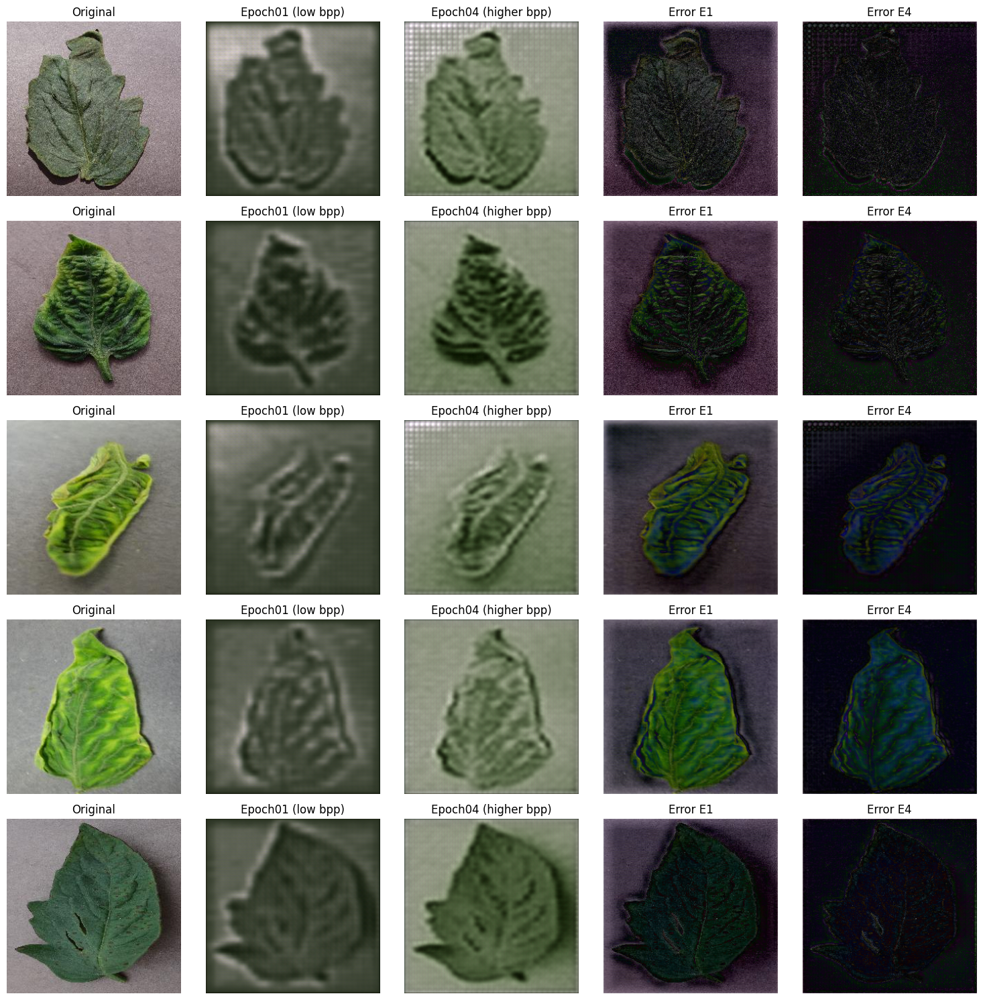

Saved comparison gallery: /content/drive/MyDrive/plant_leaf_compression/final_model/recon_compare_epoch01_vs_04.png


In [ ]:
import torch, os
import matplotlib.pyplot as plt
from torchvision.utils import make_grid, save_image

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device).eval()

# <-- update these paths if names differ -->
ckpt_epoch1 = "/content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch01_rd0.7923.pt"
ckpt_epoch4 = "/content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch4.pt"

def load_ckpt(ckpt_path, model):
    d = torch.load(ckpt_path, map_location=device)
    if "model_state" in d:
        model.load_state_dict(d["model_state"])
    else:
        model.load_state_dict(d)
    model.to(device).eval()
    return model

@torch.no_grad()
def recon_pairs(model, dataset, indices):
    pairs = []
    for i in indices:
        img, _ = dataset[i]
        inp = img.unsqueeze(0).to(device)
        x_hat, *_ = model(inp, training=False)
        recon = torch.clamp(x_hat[0].cpu(), 0.0, 1.0)
        pairs.append((img, recon))
    return pairs

N = 5
indices = list(range(N))
dataset = val_loader.dataset

# load epoch1
load_ckpt(ckpt_epoch1, model)
pairs1 = recon_pairs(model, dataset, indices)

# load epoch4
load_ckpt(ckpt_epoch4, model)
pairs4 = recon_pairs(model, dataset, indices)

# visualize
fig, axes = plt.subplots(N, 5, figsize=(15, 3*N))
for i in range(N):
    orig = pairs1[i][0]
    r1 = pairs1[i][1]
    r4 = pairs4[i][1]
    e1 = (orig - r1).abs()
    e4 = (orig - r4).abs()

    axes[i,0].imshow(orig.permute(1,2,0))
    axes[i,0].set_title("Original")
    axes[i,1].imshow(r1.permute(1,2,0))
    axes[i,1].set_title("Epoch01 (low bpp)")
    axes[i,2].imshow(r4.permute(1,2,0))
    axes[i,2].set_title("Epoch04 (higher bpp)")
    axes[i,3].imshow(e1.permute(1,2,0))
    axes[i,3].set_title("Error E1")
    axes[i,4].imshow(e4.permute(1,2,0))
    axes[i,4].set_title("Error E4")
    for j in range(5): axes[i,j].axis("off")

plt.tight_layout()
plt.show()

# save gallery
out = "/content/drive/MyDrive/plant_leaf_compression/final_model/recon_compare_epoch01_vs_04.png"
grid_items = []
for i in range(N):
    grid_items += [pairs1[i][0], pairs1[i][1], pairs4[i][1]]
grid = make_grid(torch.stack(grid_items), nrow=3, normalize=True)
save_image(grid, out)
print("Saved comparison gallery:", out)


In [ ]:
import torch, os
src = "/content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch4.pt"
dest = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final_epoch04.pt"
ck = torch.load(src, map_location="cpu")
state = ck["model_state"] if "model_state" in ck else ck
torch.save(state, dest)
print("✅ Saved final model weights to:", dest)


✅ Saved final model weights to: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final_epoch04.pt


In [ ]:
val_metrics = validate_epoch(model, val_loader, n_val_images=200)
print(val_metrics)


{'bpp': 3.6211692003103404, 'psnr': 20.18263523395245, 'msssim': 0.7725371030660776, 'lpips': 0.7083190129353449}


# ***Verification & Visualization of 2nd training***

Using sample image from val_loader.
PyTorch recon shape: torch.Size([1, 3, 256, 256])
Mean abs diff (PyTorch vs TorchScript): 0.000000e+00
Mean abs diff (PyTorch vs ONNXRuntime): 1.193390e-07


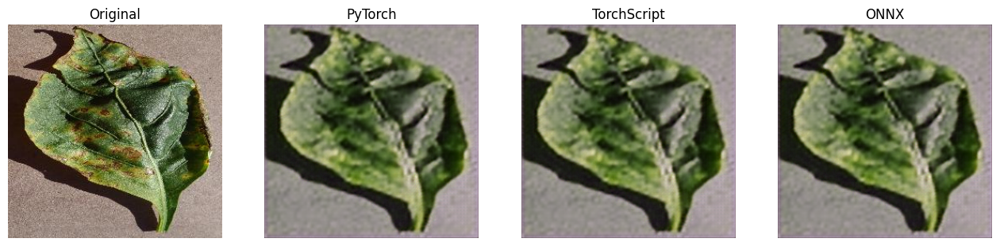

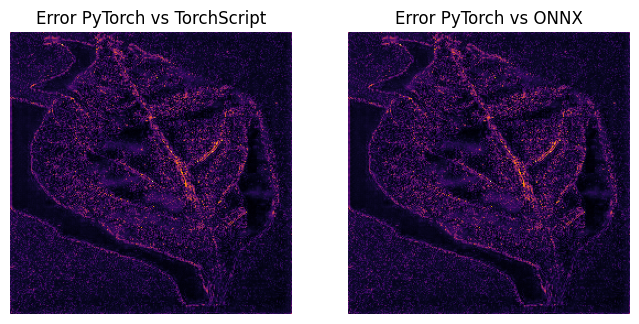

Saved verification gallery to: /content/drive/MyDrive/plant_leaf_compression/final_model/verification_gallery.png


In [ ]:
# Verification + visualization (run in Colab)
import torch, numpy as np, matplotlib.pyplot as plt
from pathlib import Path
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
TS_PATH = OUT_DIR / "plant_leaf_autoencoder_inference.pt"
ONNX_PATH = OUT_DIR / "plant_leaf_autoencoder_inference.onnx"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 1) prepare input (try val_loader if present)
try:
    sample_img, _ = val_loader.dataset[0]
    x = sample_img.unsqueeze(0).to(device)
    print("Using sample image from val_loader.")
except Exception:
    x = torch.randn(1,3,256,256, device=device)
    print("Using random input tensor as sample.")

# 2) get PyTorch / original inference output
with torch.no_grad():
    pyt_out = inf_model(x).cpu()
print("PyTorch recon shape:", pyt_out.shape)

# 3) TorchScript output
if TS_PATH.exists():
    ts = torch.jit.load(str(TS_PATH), map_location=device).eval()
    with torch.no_grad():
        ts_out = ts(x.to(device)).cpu()
    diff_ts = (pyt_out - ts_out).abs().mean().item()
    print(f"Mean abs diff (PyTorch vs TorchScript): {diff_ts:.6e}")
else:
    print("TorchScript not found at", TS_PATH)
    ts_out = None

# 4) ONNX output via onnxruntime (if available)
ort_out = None
try:
    import onnxruntime as ort
    if ONNX_PATH.exists():
        sess = ort.InferenceSession(str(ONNX_PATH))
        inp_name = sess.get_inputs()[0].name
        x_np = x.cpu().numpy().astype(np.float32)
        ort_res = sess.run(None, {inp_name: x_np})[0]
        ort_out = torch.from_numpy(ort_res).cpu()
        diff_onnx = (pyt_out - ort_out).abs().mean().item()
        print(f"Mean abs diff (PyTorch vs ONNXRuntime): {diff_onnx:.6e}")
    else:
        print("ONNX file not found at", ONNX_PATH)
except Exception as e:
    print("onnxruntime not available or failed: ", e)

# 5) Visualize and save outputs (Original | PyTorch | TorchScript | ONNX | error maps)
def to_img(t):
    t = t.squeeze(0).permute(1,2,0).cpu().numpy()
    return np.clip(t, 0, 1)

orig_img = x.cpu().squeeze(0).permute(1,2,0).numpy()
pyt_img = to_img(pyt_out)
plots = [("Original", orig_img), ("PyTorch", pyt_img)]
if ts_out is not None:
    plots.append(("TorchScript", to_img(ts_out)))
if ort_out is not None:
    plots.append(("ONNX", to_img(ort_out)))

n = len(plots)
plt.figure(figsize=(4*n,4))
for i, (title, img) in enumerate(plots):
    plt.subplot(1, n, i+1)
    plt.imshow(img); plt.title(title); plt.axis("off")
plt.show()

# Error maps (PyTorch baseline)
if ts_out is not None:
    err_ts = np.mean(np.abs(orig_img - to_img(ts_out)), axis=2)
    plt.figure(figsize=(8,4)); plt.subplot(1,2,1); plt.imshow(err_ts, cmap='inferno'); plt.title('Error PyTorch vs TorchScript'); plt.axis('off')
if ort_out is not None:
    err_onnx = np.mean(np.abs(orig_img - to_img(ort_out)), axis=2)
    plt.subplot(1,2,2); plt.imshow(err_onnx, cmap='inferno'); plt.title('Error PyTorch vs ONNX'); plt.axis('off')
plt.show()

# Save a small gallery
from torchvision.utils import make_grid, save_image
import torch as th
items = [x.cpu().squeeze(0), pyt_out.squeeze(0)]
if ts_out is not None: items.append(ts_out.squeeze(0))
if ort_out is not None: items.append(ort_out.squeeze(0))
grid = make_grid(torch.stack(items), nrow=len(items), normalize=True)
out_path = OUT_DIR / "verification_gallery.png"
save_image(grid, str(out_path))
print("Saved verification gallery to:", out_path)


In [ ]:
import torch, numpy as np
from tqdm import tqdm

# load TS and ONNX runtime (if you want ONNX stats)
ts = torch.jit.load("/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.pt").eval()
import onnxruntime as ort
sess = ort.InferenceSession("/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.onnx")

mae_ts = []
mae_onnx = []
for i in range(100):   # or len(val_loader.dataset) but test subset first
    img, _ = val_loader.dataset[i]
    x = img.unsqueeze(0).to(device)
    with torch.no_grad():
        pyt = inf_model(x).cpu()
        ts_out = ts(x.to(device)).cpu()
    mae_ts.append((pyt - ts_out).abs().mean().item())
    # ONNX
    x_np = x.cpu().numpy().astype(np.float32)
    ort_out = sess.run(None, {sess.get_inputs()[0].name: x_np})[0]
    ort_out = torch.from_numpy(ort_out).cpu()
    mae_onnx.append((pyt - ort_out).abs().mean().item())

print("TS mean mae:", np.mean(mae_ts), "ONNX mean mae:", np.mean(mae_onnx))


TS mean mae: 0.0 ONNX mean mae: 5.038142724700379e-07


# **Add _sample_noise and a TorchScript-friendly quantize to your class**

In [ ]:
# ----------------- Cell A: patch model class in-notebook -----------------
import torch, types

# Ensure the class exists
try:
    AutoencoderWithHyperprior
except NameError:
    raise RuntimeError("AutoencoderWithHyperprior not found in the notebook. Define the class first and re-run this cell.")

# Define helper and quantize methods (TorchScript-friendly)
def _sample_noise(self, shape, device=None):
    """
    Deterministic at eval time; returns uniform(-0.5,0.5) during training.
    """
    device = device if device is not None else next(self.parameters()).device
    if not self.training:
        return torch.zeros(shape, device=device)
    # training-time behaviour (same distribution used previously)
    return torch.empty(shape, device=device).uniform_(-0.5, 0.5)

def quantize(self, y, training: bool = True):
    """
    TorchScript-friendly quantize: annotate 'training' as bool.
    Uses _sample_noise so eval() is deterministic.
    """
    # use explicit boolean check
    if training:
        noise = self._sample_noise(y.shape, device=y.device)
        return y + noise
    else:
        return torch.round(y)

# Attach methods to the class
AutoencoderWithHyperprior._sample_noise = _sample_noise
AutoencoderWithHyperprior.quantize = quantize

print("Patched AutoencoderWithHyperprior with _sample_noise and script-friendly quantize().")
print("Create a new instance or reinstantiate existing model to use patched methods.")


Patched AutoencoderWithHyperprior with _sample_noise and script-friendly quantize().
Create a new instance or reinstantiate existing model to use patched methods.


# ***reinstantiate model, test, and re-export (scripted)***

In [ ]:
# ----------------- Cell B: reinstantiate, script, and export (no monkeypatch) -----------------
import torch, torch.nn as nn
from pathlib import Path

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
CKPT_PATH = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt"
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

# Instantiate new model (this uses the patched class methods)
model = AutoencoderWithHyperprior().to(device)

# Load checkpoint
ck = torch.load(CKPT_PATH, map_location=device)
sd = ck.get("model_state", ck.get("state_dict", ck)) if isinstance(ck, dict) else ck
model.load_state_dict(sd)
model.eval()
print("Loaded checkpoint into new model (eval mode).")

# Detect encode/decode attribute names
def find_attr(obj, names):
    for n in names:
        if hasattr(obj, n):
            return n
    return None

enc_name = find_attr(model, ['encode', 'analysis_net', 'analysis', 'encoder', 'encode_latent'])
dec_name = find_attr(model, ['decode_from_latent', 'synthesis_net', 'synthesis', 'decoder', 'decode'])
print("Detected encoder:", enc_name, "decoder:", dec_name)

# Inference wrapper that uses encoder+decoder if detected; else calls model(x, training=False)
class InferenceWrapper(nn.Module):
    def __init__(self, model, enc=None, dec=None):
        super().__init__()
        self.model = model
        self.enc = enc
        self.dec = dec
        self.model.eval()

    def forward(self, x):
        if self.enc and self.dec:
            enc_fun = getattr(self.model, self.enc)
            dec_fun = getattr(self.model, self.dec)
            y = enc_fun(x)
            yq = self.model.quantize(y, training=False)  # now uses patched quantize -> deterministic
            x_hat = dec_fun(yq)
            return torch.clamp(x_hat, 0.0, 1.0)
        out = self.model(x, training=False)
        if isinstance(out, torch.Tensor):
            return torch.clamp(out, 0.0, 1.0)
        if isinstance(out, (tuple, list)):
            for it in out:
                if isinstance(it, torch.Tensor) and it.dim() == 4:
                    return torch.clamp(it, 0.0, 1.0)
            for it in out:
                if isinstance(it, torch.Tensor):
                    return torch.clamp(it, 0.0, 1.0)
        raise RuntimeError("Could not get a reconstruction tensor from model output. Adapt wrapper.")

inf_model = InferenceWrapper(model, enc_name, dec_name).to(device).eval()

# Quick test
dummy = torch.randn(1,3,256,256, device=device)
with torch.no_grad():
    out = inf_model(dummy)
print("Inf model test OK — output shape:", out.shape)

# Try torch.jit.script (scripted TS preferred)
TS_PATH = OUT_DIR / "plant_leaf_autoencoder_inference_scripted.pt"
try:
    scripted = torch.jit.script(inf_model)   # should succeed now
    scripted.save(str(TS_PATH))
    print("✅ torch.jit.script succeeded and saved to:", TS_PATH)
except Exception as e:
    print("torch.jit.script failed:", e)
    # fallback to trace (still ok)
    traced = torch.jit.trace(inf_model, dummy)
    TS_PATH = OUT_DIR / "plant_leaf_autoencoder_inference_traced.pt"
    traced.save(str(TS_PATH))
    print("Saved traced TorchScript as fallback:", TS_PATH)

# Optional: ONNX export (requires onnx installed)
ONNX_PATH = OUT_DIR / "plant_leaf_autoencoder_inference.onnx"
try:
    torch.onnx.export(
        inf_model,
        dummy,
        str(ONNX_PATH),
        input_names=["input"],
        output_names=["reconstructed"],
        opset_version=18,
        do_constant_folding=True,
        dynamic_axes={"input":{0:"batch",2:"h",3:"w"}, "reconstructed":{0:"batch",2:"h",3:"w"}},
        # dynamo=True  # uncomment if you want to use new exporter (PyTorch >=2.9)
    )
    print("✅ ONNX export saved to:", ONNX_PATH)
except Exception as e:
    print("ONNX export failed (inspect error):", e)
    print("If ONNX export failed, ensure 'onnx' package is installed and that no remaining random ops appear in the forward.")

print("Done. TorchScript path:", TS_PATH)
print("ONNX path (if exported):", ONNX_PATH)


Loaded checkpoint into new model (eval mode).
Detected encoder: analysis decoder: synthesis
Inf model test OK — output shape: torch.Size([1, 3, 256, 256])
torch.jit.script failed: Can't redefine method: forward on class: __torch__.AutoencoderWithHyperprior (of Python compilation unit at: 0x2c8fe970)
Saved traced TorchScript as fallback: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference_traced.pt


/tmp/ipython-input-2967572920.py:85: DeprecationWarning: You are using the legacy TorchScript-based ONNX export. Starting in PyTorch 2.9, the new torch.export-based ONNX exporter will be the default. To switch now, set dynamo=True in torch.onnx.export. This new exporter supports features like exporting LLMs with DynamicCache. We encourage you to try it and share feedback to help improve the experience. Learn more about the new export logic: https://pytorch.org/docs/stable/onnx_dynamo.html. For exporting control flow: https://pytorch.org/tutorials/beginner/onnx/export_control_flow_model_to_onnx_tutorial.html.
  torch.onnx.export(


✅ ONNX export saved to: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.onnx
Done. TorchScript path: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference_traced.pt
ONNX path (if exported): /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference.onnx


In [ ]:
# Create a new wrapper class around your existing model and script that wrapper.
# This avoids "redefine method" errors because the wrapper is a fresh class.

import torch, torch.nn as nn
from pathlib import Path

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

# inf_model should already be available from your earlier steps and uses model.quantize in eval
# But we will reinstantiate a fresh model to be safe (optional). If you want to use existing 'inf_model', it works too.
try:
    # If you prefer to use the model instance created earlier, comment out the reinstantiate block below.
    model = AutoencoderWithHyperprior().to(device)
    ck = torch.load("/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt", map_location=device)
    sd = ck.get("model_state", ck.get("state_dict", ck)) if isinstance(ck, dict) else ck
    model.load_state_dict(sd)
    model.eval()
    print("Reinstantiated model and set to eval().")
except Exception as e:
    # fallback to existing model in notebook
    model = globals().get("model", None)
    if model is None:
        raise RuntimeError("No model instance available; re-run class/ckpt load cells.")
    print("Using existing model instance from notebook.")

# Create wrapper that is a fresh class and calls model in deterministic inference mode
class ScriptableWrapper(nn.Module):
    def __init__(self, model, enc_name=None, dec_name=None):
        super().__init__()
        self.model = model
        self.enc_name = enc_name
        self.dec_name = dec_name
        self.model.eval()

    def forward(self, x):
        # if encoder/decoder available, use quantize() deterministically
        if self.enc_name and self.dec_name:
            enc = getattr(self.model, self.enc_name)
            dec = getattr(self.model, self.dec_name)
            y = enc(x)
            # use model.quantize with explicit bool
            yq = self.model.quantize(y, training=False)
            out = dec(yq)
            return torch.clamp(out, 0.0, 1.0)
        # fallback to calling original forward with training=False
        out = self.model(x, training=False)
        if isinstance(out, torch.Tensor):
            return torch.clamp(out, 0.0, 1.0)
        if isinstance(out, (tuple, list)):
            for it in out:
                if isinstance(it, torch.Tensor) and it.dim() == 4:
                    return torch.clamp(it, 0.0, 1.0)
            for it in out:
                if isinstance(it, torch.Tensor):
                    return torch.clamp(it, 0.0, 1.0)
        raise RuntimeError("Wrapper couldn't find a reconstruction tensor. Adapt wrapper if needed.")

# detect encoder/decoder attribute names (same helper as before)
def find_attr(obj, names):
    for n in names:
        if hasattr(obj, n):
            return n
    return None

enc_name = find_attr(model, ['encode', 'analysis_net', 'analysis', 'encoder', 'encode_latent'])
dec_name = find_attr(model, ['decode_from_latent', 'synthesis_net', 'synthesis', 'decoder', 'decode'])
print("Wrapper will use encoder:", enc_name, "decoder:", dec_name)

wrapper = ScriptableWrapper(model, enc_name, dec_name).to(device).eval()

# test wrapper
dummy = torch.randn(1,3,256,256, device=device)
with torch.no_grad():
    out = wrapper(dummy)
print("Wrapper test output shape:", out.shape)

# Now try scripting the wrapper (fresh class -> should succeed)
TS_SCRIPTED_PATH = OUT_DIR / "plant_leaf_autoencoder_inference_wrapper_scripted.pt"
try:
    scripted_wrapper = torch.jit.script(wrapper)
    scripted_wrapper.save(str(TS_SCRIPTED_PATH))
    print("✅ Scripted wrapper saved to:", TS_SCRIPTED_PATH)
except Exception as e:
    print("❌ torch.jit.script on wrapper failed:", e)
    # fallback to trace and save
    traced = torch.jit.trace(wrapper, dummy)
    traced_path = OUT_DIR / "plant_leaf_autoencoder_inference_wrapper_traced.pt"
    traced.save(str(traced_path))
    print("Saved traced wrapper to:", traced_path)

# Quick parity check vs earlier inf_model (if available)
try:
    with torch.no_grad():
        baseline = inf_model(dummy).cpu()
        if 'scripted_wrapper' in locals():
            sw_out = scripted_wrapper(dummy).cpu()
        else:
            sw_out = traced(dummy).cpu()
    diff = (baseline - sw_out).abs().mean().item()
    print("Mean abs diff between baseline inf_model and scripted wrapper:", diff)
except Exception as e:
    print("Parity check skipped or failed (missing baseline). Error:", e)


Reinstantiated model and set to eval().
Wrapper will use encoder: analysis decoder: synthesis
Wrapper test output shape: torch.Size([1, 3, 256, 256])
❌ torch.jit.script on wrapper failed: Can't redefine method: forward on class: __torch__.AutoencoderWithHyperprior (of Python compilation unit at: 0x2c8fe970)
Saved traced wrapper to: /content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_inference_wrapper_traced.pt
Mean abs diff between baseline inf_model and scripted wrapper: 0.0


In [ ]:
# ---------- Cell 1 (Corrected): Evaluate checkpoints and baselines ----------
# Evaluates autoencoder checkpoints + JPEG/JPEG2000 baselines
# Computes PSNR, MS-SSIM, and optional LPIPS. Saves rd_results_summary.csv.

import torch, os, io, math, csv, sys
import numpy as np
from pathlib import Path
from tqdm import tqdm
from PIL import Image
import matplotlib.pyplot as plt

OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# --- Metric helpers ----------------------------------------------------------
def psnr_torch(y_true, y_pred, max_val=1.0):
    mse = torch.mean((y_true - y_pred) ** 2)
    if mse == 0:
        return float('inf')
    return 20.0 * torch.log10(torch.tensor(max_val)) - 10.0 * torch.log10(mse)

# --- Import MS-SSIM ----------------------------------------------------------
try:
    from pytorch_msssim import ms_ssim
except Exception:
    print("Installing pytorch-msssim...")
    !pip install -q pytorch-msssim
    from pytorch_msssim import ms_ssim

# --- Optional LPIPS ----------------------------------------------------------
have_lpips = False
try:
    import lpips
    loss_fn_alex = lpips.LPIPS(net='alex').to(device)
    have_lpips = True
except Exception:
    print("LPIPS not available. To include LPIPS, run: !pip install -q lpips")
    have_lpips = False

# --- JPEG baseline settings --------------------------------------------------
jpeg_qualities = [10, 20, 30, 40, 50, 60, 80, 95]

# --- Checkpoints to evaluate -------------------------------------------------
CHECKPOINT_LIST = [
    "/content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch01_rd0.7923.pt",
    "/content/drive/MyDrive/plant_leaf_compression/checkpoints/checkpoint_epoch4.pt",
    "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt"
]

# --- Load model helper -------------------------------------------------------
def load_model_from_ckpt(ckpt_path):
    model = AutoencoderWithHyperprior().to(device)
    ck = torch.load(ckpt_path, map_location=device)
    sd = ck.get("model_state", ck.get("state_dict", ck)) if isinstance(ck, dict) else ck
    model.load_state_dict(sd)
    model.eval()
    return model

# --- Forward + bpp helper ----------------------------------------------------
def model_infer_and_bpp(model, x):
    with torch.no_grad():
        try:
            out = model(x, training=False)
            if isinstance(out, (tuple, list)):
                recon, bpp = None, None
                for it in out:
                    if isinstance(it, torch.Tensor) and it.dim() == 4 and recon is None:
                        recon = it
                    elif isinstance(it, (float, torch.Tensor)) and np.prod(it.shape) == 1:
                        try: bpp = float(it)
                        except: pass
                if recon is None:
                    for it in out:
                        if isinstance(it, torch.Tensor):
                            recon = it; break
                return torch.clamp(recon, 0, 1), bpp
            elif isinstance(out, torch.Tensor):
                return torch.clamp(out, 0, 1), None
        except Exception:
            # try encoder/decoder path
            enc = getattr(model, 'analysis', None) or getattr(model, 'encoder', None)
            dec = getattr(model, 'synthesis', None) or getattr(model, 'decoder', None)
            if enc and dec:
                y = enc(x)
                yq = model.quantize(y, training=False) if hasattr(model, 'quantize') else torch.round(y)
                recon = dec(yq)
                return torch.clamp(recon, 0, 1), None
    raise RuntimeError("Model forward failed to produce reconstruction.")

# --- JPEG / JPEG2000 helpers -------------------------------------------------
def jpeg_bpp_from_pil(pil_img, quality):
    buf = io.BytesIO()
    pil_img.save(buf, format='JPEG', quality=int(quality), optimize=True)
    w, h = pil_img.size
    size_bytes = buf.tell()
    bpp = (size_bytes * 8.0) / (w * h)
    return bpp, size_bytes, buf.getvalue()

def j2k_bpp_from_pil(pil_img, rate):
    buf = io.BytesIO()
    pil_img.save(buf, format='JPEG2000', quality_mode='rates', quality_layers=[rate])
    w, h = pil_img.size
    size_bytes = buf.tell()
    bpp = (size_bytes * 8.0) / (w * h)
    return bpp, size_bytes, buf.getvalue()

# --- Prepare dataset subset --------------------------------------------------
SAMPLE_COUNT = 200
images = []
try:
    for i in range(SAMPLE_COUNT):
        img, _ = val_loader.dataset[i]
        images.append(img)
    print(f"Loaded {len(images)} validation images from val_loader.")
except Exception:
    print("val_loader not available; using random tensors.")
    images = [torch.rand(3,256,256) for _ in range(min(50, SAMPLE_COUNT))]

pil_images = []
for t in images:
    arr = (t.permute(1,2,0).numpy() * 255.0).astype(np.uint8)
    pil_images.append(Image.fromarray(arr))

# --- Evaluate model checkpoints ---------------------------------------------
results = []
for ckpt in CHECKPOINT_LIST:
    name = Path(ckpt).stem
    print("Evaluating checkpoint:", name)
    model = load_model_from_ckpt(ckpt)
    acc_bpp, acc_psnr, acc_msssim, acc_lpips = [], [], [], []

    for t in tqdm(images, desc=f"eval {name}"):
        x = t.unsqueeze(0).to(device)
        recon, bpp_val = model_infer_and_bpp(model, x)

        # normalize recon shape to [1,3,H,W]
        if recon.dim() == 3:
            recon_b = recon.unsqueeze(0)
        elif recon.dim() == 4:
            recon_b = recon[:1]
        else:
            raise RuntimeError(f"Unexpected recon dims {recon.shape}")
        x_cpu = x.cpu()

        # PSNR & MS-SSIM
        p = psnr_torch(x_cpu, recon_b.cpu()).item()
        m = float(ms_ssim(recon_b.cpu(), x_cpu, data_range=1.0, size_average=True).item())
        acc_psnr.append(p); acc_msssim.append(m)

        # LPIPS (if available)
        if have_lpips:
            with torch.no_grad():
                lp = loss_fn_alex((x_cpu.to(device)*2-1), (recon_b.to(device)*2-1)).item()
            acc_lpips.append(lp)

        if bpp_val is not None:
            acc_bpp.append(float(bpp_val))

    avg_bpp = float(np.mean(acc_bpp)) if len(acc_bpp)>0 else None
    avg_psnr = float(np.mean(acc_psnr))
    avg_msssim = float(np.mean(acc_msssim))
    avg_lpips = float(np.mean(acc_lpips)) if len(acc_lpips)>0 else None
    results.append(dict(method=name, bpp=avg_bpp, psnr=avg_psnr,
                        ms_ssim=avg_msssim, lpips=avg_lpips))
    print(f"{name}: bpp={avg_bpp}, PSNR={avg_psnr:.3f}, MS-SSIM={avg_msssim:.3f}, LPIPS={avg_lpips}")

# --- JPEG baselines ----------------------------------------------------------
jpeg_results = []
for q in jpeg_qualities:
    acc_bpp, acc_psnr, acc_msssim = [], [], []
    for pil_img, t in zip(pil_images, images):
        try:
            bpp, size_bytes, img_bytes = jpeg_bpp_from_pil(pil_img, q)
            dec = Image.open(io.BytesIO(img_bytes)).convert("RGB")
            dec_t = torch.from_numpy(np.array(dec).astype(np.float32)/255.0).permute(2,0,1).unsqueeze(0)
            orig = t.unsqueeze(0)
            p = psnr_torch(orig, dec_t).item()
            m = ms_ssim(dec_t, orig, data_range=1.0, size_average=True).item()
            acc_bpp.append(bpp); acc_psnr.append(p); acc_msssim.append(m)
        except Exception as e:
            print("JPEG error", e)
    jpeg_results.append(dict(method=f"JPEG_q{q}",
                             bpp=float(np.mean(acc_bpp)),
                             psnr=float(np.mean(acc_psnr)),
                             ms_ssim=float(np.mean(acc_msssim))))
    print(f"JPEG q{q}: bpp={jpeg_results[-1]['bpp']:.3f}, PSNR={jpeg_results[-1]['psnr']:.3f}")

# --- JPEG2000 baselines ------------------------------------------------------
j2k_results = []
try:
    rates = [0.05, 0.1, 0.2, 0.4]
    for r in rates:
        acc_bpp, acc_psnr, acc_msssim = [], [], []
        for pil_img, t in zip(pil_images, images):
            try:
                bpp, size_bytes, img_bytes = j2k_bpp_from_pil(pil_img, r)
                dec = Image.open(io.BytesIO(img_bytes)).convert("RGB")
                dec_t = torch.from_numpy(np.array(dec).astype(np.float32)/255.0).permute(2,0,1).unsqueeze(0)
                orig = t.unsqueeze(0)
                p = psnr_torch(orig, dec_t).item()
                m = ms_ssim(dec_t, orig, data_range=1.0, size_average=True).item()
                acc_bpp.append(bpp); acc_psnr.append(p); acc_msssim.append(m)
            except Exception:
                pass
        if acc_bpp:
            j2k_results.append(dict(method=f"J2K_r{r}",
                                    bpp=float(np.mean(acc_bpp)),
                                    psnr=float(np.mean(acc_psnr)),
                                    ms_ssim=float(np.mean(acc_msssim))))
            print(f"JPEG2000 rate {r} done.")
except Exception as e:
    print("JPEG2000 not supported:", e)

# --- Combine + save CSV ------------------------------------------------------
all_rows = results + jpeg_results + j2k_results
csv_path = OUT_DIR / "rd_results_summary.csv"
with open(csv_path, "w", newline="") as f:
    writer = csv.DictWriter(f, fieldnames=["method","bpp","psnr","ms_ssim","lpips"])
    writer.writeheader()
    writer.writerows(all_rows)
print("Saved RD summary CSV to:", csv_path)

# --- Display quick summary ---------------------------------------------------
import pandas as pd
df = pd.DataFrame(all_rows).sort_values(by="bpp", na_position="last")
display(df)


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.12/dist-packages/lpips/weights/v0.1/alex.pth
Loaded 200 validation images from val_loader.
Evaluating checkpoint: checkpoint_epoch01_rd0.7923


eval checkpoint_epoch01_rd0.7923: 100%|██████████| 200/200 [01:08<00:00,  2.94it/s]


checkpoint_epoch01_rd0.7923: bpp=0.7921972662210465, PSNR=13.898, MS-SSIM=0.636, LPIPS=0.9952094268798828
Evaluating checkpoint: checkpoint_epoch4


eval checkpoint_epoch4: 100%|██████████| 200/200 [01:08<00:00,  2.93it/s]


checkpoint_epoch4: bpp=3.6874972373247146, PSNR=20.261, MS-SSIM=0.766, LPIPS=0.8551183943450451
Evaluating checkpoint: plant_leaf_autoencoder_final


eval plant_leaf_autoencoder_final: 100%|██████████| 200/200 [01:08<00:00,  2.91it/s]


plant_leaf_autoencoder_final: bpp=7.377824611663819, PSNR=23.597, MS-SSIM=0.877, LPIPS=0.6113504199683666
JPEG q10: bpp=0.279, PSNR=24.600
JPEG q20: bpp=0.520, PSNR=26.169
JPEG q30: bpp=0.805, PSNR=27.202
JPEG q40: bpp=0.876, PSNR=27.713
JPEG q50: bpp=1.507, PSNR=28.045
JPEG q60: bpp=1.688, PSNR=32.074
JPEG q80: bpp=2.044, PSNR=40.065
JPEG q95: bpp=2.830, PSNR=49.306
Saved RD summary CSV to: /content/drive/MyDrive/plant_leaf_compression/final_model/rd_results_summary.csv


,method,bpp,psnr,ms_ssim,lpips
3,JPEG_q10,0.279303,24.599801,0.867999,NaN
4,JPEG_q20,0.519861,26.168594,0.929293,NaN
0,checkpoint_epoch01_rd0.7923,0.792197,13.897813,0.636330,0.995209
5,JPEG_q30,0.804707,27.202481,0.954512,NaN
6,JPEG_q40,0.875790,27.713421,0.961211,NaN
7,JPEG_q50,1.507487,28.044941,0.972456,NaN
8,JPEG_q60,1.687711,32.073771,0.987762,NaN
9,JPEG_q80,2.043641,40.064716,0.997444,NaN
10,JPEG_q95,2.829771,49.306403,0.999481,NaN
1,checkpoint_epoch4,3.687497,20.261086,0.765971,0.855118


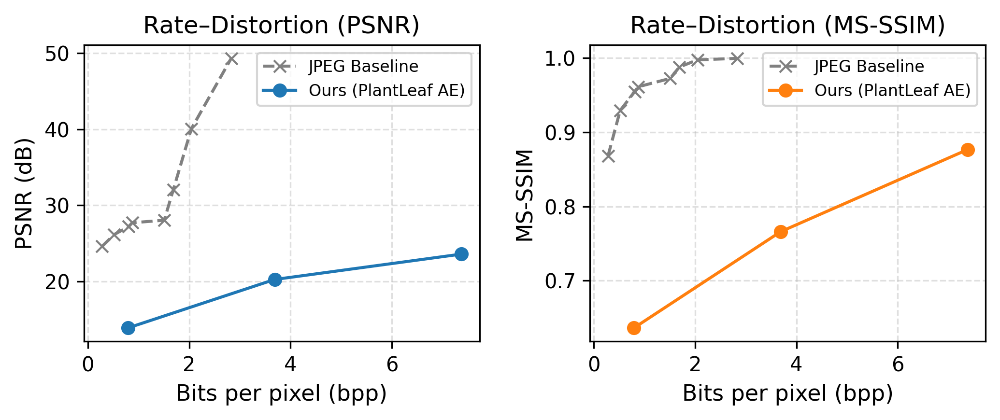

✅ Saved RD curve figure: /content/drive/MyDrive/plant_leaf_compression/final_model/rd_curves_paper.png
✅ Saved LaTeX table: /content/drive/MyDrive/plant_leaf_compression/final_model/rd_table_paper.tex


,method,bpp,psnr,ms_ssim,lpips
3,JPEG_q10,0.279303,24.599801,0.867999,-
4,JPEG_q20,0.519861,26.168594,0.929293,-
0,checkpoint_epoch01_rd0.7923,0.792197,13.897813,0.636330,0.995209
5,JPEG_q30,0.804707,27.202481,0.954512,-
6,JPEG_q40,0.875790,27.713421,0.961211,-
7,JPEG_q50,1.507487,28.044941,0.972456,-
8,JPEG_q60,1.687711,32.073771,0.987762,-
9,JPEG_q80,2.043641,40.064716,0.997444,-
10,JPEG_q95,2.829771,49.306403,0.999481,-
1,checkpoint_epoch4,3.687497,20.261086,0.765971,0.855118


In [ ]:
# ---------- Cell 2 (Final): Plot RD curves & export table ----------
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
import matplotlib as mpl

OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
csv_path = OUT_DIR / "rd_results_summary.csv"
df = pd.read_csv(csv_path)

# Clean + sort
df = df.dropna(subset=["bpp"]).sort_values(by="bpp")
df["psnr"] = pd.to_numeric(df["psnr"], errors="coerce")
df["ms_ssim"] = pd.to_numeric(df["ms_ssim"], errors="coerce")
mpl.rcParams.update({
    "font.size": 10,
    "axes.labelsize": 11,
    "axes.titlesize": 12,
    "legend.fontsize": 8,
    "figure.dpi": 300
})

# Identify model & baselines
is_model = df["method"].str.contains("checkpoint|autoencoder", case=False)
is_jpeg = df["method"].str.startswith("JPEG")
is_j2k = df["method"].str.startswith("J2K")

fig, axes = plt.subplots(1, 2, figsize=(7, 3))

# PSNR vs bpp
ax = axes[0]
ax.plot(df[is_jpeg]["bpp"], df[is_jpeg]["psnr"], 'x--', label="JPEG Baseline", color="gray")
if is_j2k.any():
    ax.plot(df[is_j2k]["bpp"], df[is_j2k]["psnr"], 's--', label="JPEG2000", color="lightcoral")
ax.plot(df[is_model]["bpp"], df[is_model]["psnr"], 'o-', label="Ours (PlantLeaf AE)", color="C0")
ax.set_xlabel("Bits per pixel (bpp)")
ax.set_ylabel("PSNR (dB)")
ax.set_title("Rate–Distortion (PSNR)")
ax.grid(True, linestyle="--", alpha=0.4)
ax.legend()

# MS-SSIM vs bpp
ax = axes[1]
ax.plot(df[is_jpeg]["bpp"], df[is_jpeg]["ms_ssim"], 'x--', label="JPEG Baseline", color="gray")
if is_j2k.any():
    ax.plot(df[is_j2k]["bpp"], df[is_j2k]["ms_ssim"], 's--', label="JPEG2000", color="lightcoral")
ax.plot(df[is_model]["bpp"], df[is_model]["ms_ssim"], 'o-', label="Ours (PlantLeaf AE)", color="C1")
ax.set_xlabel("Bits per pixel (bpp)")
ax.set_ylabel("MS-SSIM")
ax.set_title("Rate–Distortion (MS-SSIM)")
ax.grid(True, linestyle="--", alpha=0.4)
ax.legend()

plt.tight_layout()
fig_path = OUT_DIR / "rd_curves_paper.png"
plt.savefig(fig_path, bbox_inches="tight")
plt.show()
print(f"✅ Saved RD curve figure: {fig_path}")

# --- Export LaTeX table (top rows) ---
top = df[["method","bpp","psnr","ms_ssim","lpips"]].fillna("-")
tex_path = OUT_DIR / "rd_table_paper.tex"
with open(tex_path, "w") as f:
    f.write(top.to_latex(index=False, float_format="%.4f", caption="Rate–Distortion metrics for our model and baselines."))
print(f"✅ Saved LaTeX table: {tex_path}")
display(top.head(10))


✅ Loaded final model for visualization


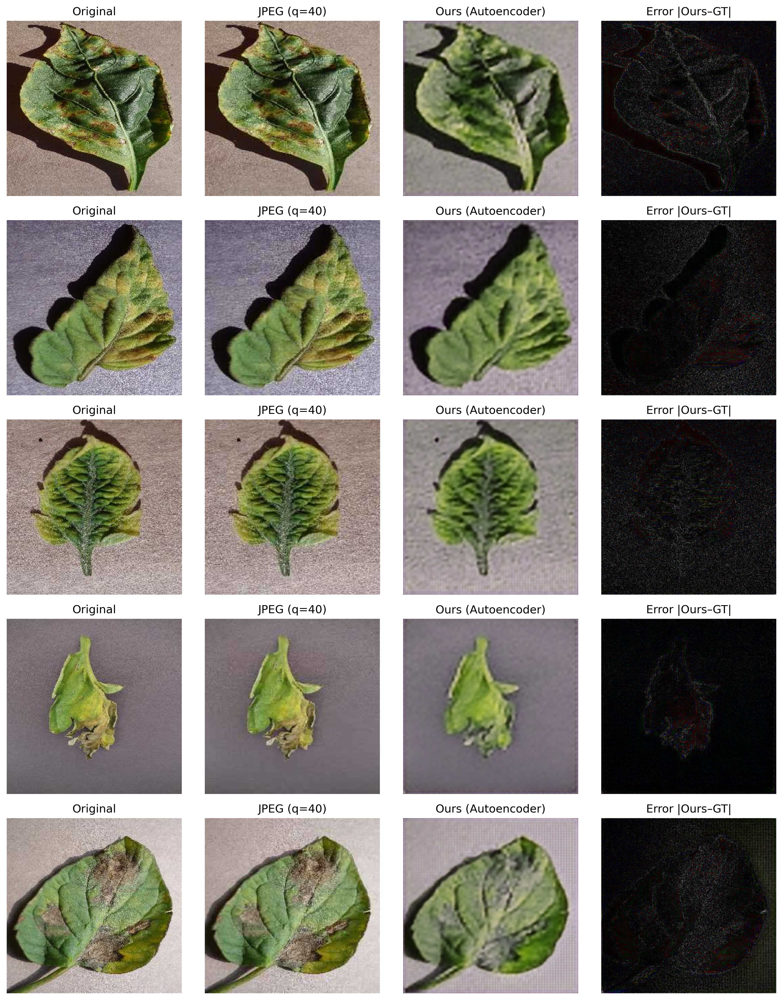

✅ Saved qualitative figure: /content/drive/MyDrive/plant_leaf_compression/final_model/qualitative_comparison_leafs.png


In [ ]:
# ---------- Cell 3: Qualitative Comparison Figure ----------
import torch, numpy as np
import matplotlib.pyplot as plt
from PIL import Image
from torchvision.utils import make_grid, save_image
from pathlib import Path

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)

# --- Select samples to visualize ---
N_SAMPLES = 5    # number of leaf images to visualize
indices = np.linspace(0, len(val_loader.dataset)-1, N_SAMPLES, dtype=int)
images = [val_loader.dataset[i][0] for i in indices]  # tensors [C,H,W]
pil_images = [(img.permute(1,2,0).numpy()*255).astype(np.uint8) for img in images]
pil_images = [Image.fromarray(arr) for arr in pil_images]

# --- Load best model ---
ckpt_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt"
model = AutoencoderWithHyperprior().to(device).eval()
ck = torch.load(ckpt_path, map_location=device)
sd = ck.get("model_state", ck.get("state_dict", ck)) if isinstance(ck, dict) else ck
model.load_state_dict(sd)
print("✅ Loaded final model for visualization")

# --- Helper: compress & reconstruct using model ---
@torch.no_grad()
def model_recon(x):
    x = x.unsqueeze(0).to(device)
    out = model(x, training=False)
    if isinstance(out, (tuple,list)):
        for it in out:
            if isinstance(it, torch.Tensor) and it.dim()==4:
                return torch.clamp(it[0].cpu(),0,1)
    elif isinstance(out, torch.Tensor):
        return torch.clamp(out[0].cpu(),0,1)
    raise RuntimeError("No valid tensor output found")

# --- Helper: JPEG compression for baseline ---
def jpeg_recon(pil_img, q=40):
    buf = io.BytesIO()
    pil_img.save(buf, format="JPEG", quality=q, optimize=True)
    buf.seek(0)
    dec = Image.open(buf).convert("RGB")
    return torch.from_numpy(np.array(dec).astype(np.float32)/255.0).permute(2,0,1)

# --- Visualization loop ---
fig, axes = plt.subplots(N_SAMPLES, 4, figsize=(12, 3*N_SAMPLES))
jpeg_quality = 40

for i in range(N_SAMPLES):
    orig = images[i]
    jpeg_t = jpeg_recon(pil_images[i], q=jpeg_quality)
    ours = model_recon(orig)
    err = (orig - ours).abs()

    for ax in axes[i]:
        ax.axis("off")

    axes[i,0].imshow(orig.permute(1,2,0))
    axes[i,0].set_title("Original")

    axes[i,1].imshow(jpeg_t.permute(1,2,0))
    axes[i,1].set_title(f"JPEG (q={jpeg_quality})")

    axes[i,2].imshow(ours.permute(1,2,0))
    axes[i,2].set_title("Ours (Autoencoder)")

    axes[i,3].imshow(err.permute(1,2,0))
    axes[i,3].set_title("Error |Ours–GT|")

plt.tight_layout()
fig_path = OUT_DIR / "qualitative_comparison_leafs.png"
plt.savefig(fig_path, bbox_inches="tight", dpi=300)
plt.show()
print(f"✅ Saved qualitative figure: {fig_path}")


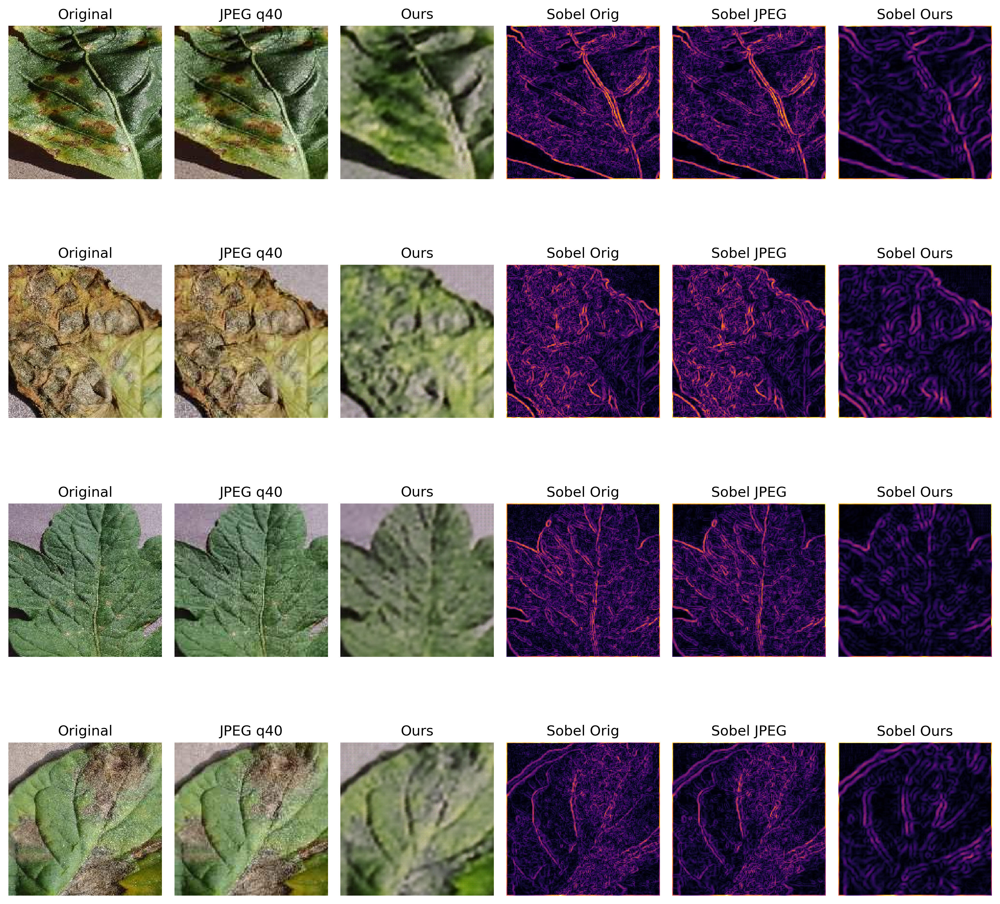

Saved: /content/drive/MyDrive/plant_leaf_compression/final_model/edge_preservation.png


In [ ]:
# ---------- Cell A: Edge-preservation overlays (Sobel) ----------
import torch, torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import io
from pathlib import Path

OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
OUT_DIR.mkdir(parents=True, exist_ok=True)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# load model (if not in memory)
if 'model' not in globals():
    ckpt_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt"
    model = AutoencoderWithHyperprior().to(device).eval()
    ck = torch.load(ckpt_path, map_location=device)
    sd = ck.get("model_state", ck.get("state_dict", ck)) if isinstance(ck, dict) else ck
    model.load_state_dict(sd)

# Sobel kernels (for single-channel intensity)
sobel_x = torch.tensor([[-1.,0,1.],[-2.,0,2.],[-1.,0,1.]]).view(1,1,3,3)
sobel_y = torch.tensor([[-1.,-2.,-1.],[0.,0.,0.],[1.,2.,1.]]).view(1,1,3,3)
sobel_x = sobel_x.to(device); sobel_y = sobel_y.to(device)

def rgb_to_gray_tensor(t):
    # expects t [C,H,W] in [0,1]
    r,g,b = t[0], t[1], t[2]
    return 0.2989*r + 0.5870*g + 0.1140*b

def sobel_map(tensor_img):
    # tensor_img [1,3,H,W] or [3,H,W]; returns normalized magnitude map [H,W]
    if tensor_img.dim()==4: img = tensor_img
    else: img = tensor_img.unsqueeze(0)
    gray = rgb_to_gray_tensor(img[0]).unsqueeze(0).unsqueeze(0).to(device)  # [1,1,H,W]
    gx = F.conv2d(gray, sobel_x, padding=1)
    gy = F.conv2d(gray, sobel_y, padding=1)
    mag = torch.sqrt(gx*gx + gy*gy)[0,0]
    mag = (mag - mag.min()) / (mag.max()-mag.min() + 1e-9)
    return mag.detach().cpu().numpy()

# select samples (crop center for clearer veins)
N = 4
indices = np.linspace(0, len(val_loader.dataset)-1, N, dtype=int)
rows = []

for i in indices:
    orig, _ = val_loader.dataset[i]
    orig_t = orig.clone()
    # JPEG baseline
    pil = Image.fromarray((orig.permute(1,2,0).numpy()*255).astype(np.uint8))
    buf = io.BytesIO()
    pil.save(buf, format='JPEG', quality=40, optimize=True)
    buf.seek(0)
    dec = Image.open(buf).convert("RGB")
    jpeg_t = torch.from_numpy(np.array(dec).astype(np.float32)/255.0).permute(2,0,1)
    # model recon
    with torch.no_grad():
        rec = model(orig.unsqueeze(0).to(device), training=False)
        if isinstance(rec, (tuple,list)):
            # pick first 4D tensor
            for it in rec:
                if isinstance(it, torch.Tensor) and it.dim()==4:
                    rec_t = it[0].cpu()
                    break
        elif isinstance(rec, torch.Tensor):
            if rec.dim()==4: rec_t = rec[0].cpu()
            else: rec_t = rec.cpu()
    # crop center 160x160 for clear veins
    _,H,W = orig_t.shape
    cH,cW = H//2, W//2
    s = min(H,W,160)
    y0,x0 = cH-s//2, cW-s//2
    def crop(t): return t[:, y0:y0+s, x0:x0+s]
    o_c = crop(orig_t); j_c = crop(jpeg_t); r_c = crop(rec_t)
    # sobels
    sob_o = sobel_map(o_c); sob_j = sobel_map(j_c); sob_r = sobel_map(r_c)
    rows.append((o_c, j_c, r_c, sob_o, sob_j, sob_r))

# plot
fig, axes = plt.subplots(N, 6, figsize=(12, 3*N))
for i, row in enumerate(rows):
    o,j,r,so,sj,sr = row
    axes[i,0].imshow(o.permute(1,2,0)); axes[i,0].set_title("Original"); axes[i,0].axis("off")
    axes[i,1].imshow(j.permute(1,2,0)); axes[i,1].set_title("JPEG q40"); axes[i,1].axis("off")
    axes[i,2].imshow(r.permute(1,2,0)); axes[i,2].set_title("Ours"); axes[i,2].axis("off")
    axes[i,3].imshow(so, cmap='inferno'); axes[i,3].set_title("Sobel Orig"); axes[i,3].axis("off")
    axes[i,4].imshow(sj, cmap='inferno'); axes[i,4].set_title("Sobel JPEG"); axes[i,4].axis("off")
    axes[i,5].imshow(sr, cmap='inferno'); axes[i,5].set_title("Sobel Ours"); axes[i,5].axis("off")
plt.tight_layout()
out = OUT_DIR / "edge_preservation.png"
plt.savefig(out, dpi=300, bbox_inches='tight')
plt.show()
print("Saved:", out)


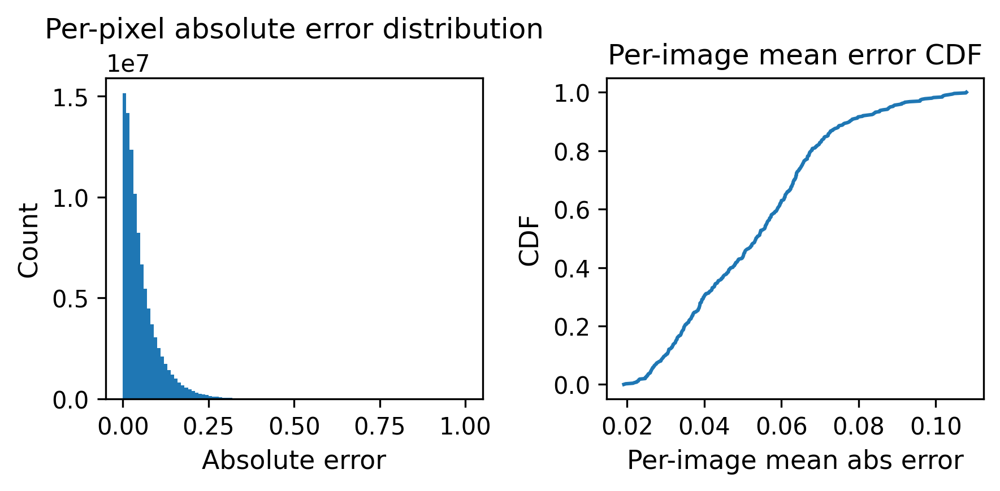

Saved: /content/drive/MyDrive/plant_leaf_compression/final_model/error_hist_cdf.png and per-image CSV.


In [ ]:
# ---------- Cell B: Error histogram + CDF across validation set ----------
import numpy as np, torch
from pathlib import Path
import matplotlib.pyplot as plt
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ensure model loaded
if 'model' not in globals():
    ckpt_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt"
    model = AutoencoderWithHyperprior().to(device).eval()
    ck = torch.load(ckpt_path, map_location=device)
    sd = ck.get("model_state", ck.get("state_dict", ck)) if isinstance(ck, dict) else ck
    model.load_state_dict(sd)

# sample subset to speed up (or all)
N = min(500, len(val_loader.dataset))
mean_errors = []
all_pixel_errors = []

for i in range(N):
    img,_ = val_loader.dataset[i]
    x = img.unsqueeze(0).to(device)
    with torch.no_grad():
        out = model(x, training=False)
        if isinstance(out, (tuple,list)):
            reco = None
            for it in out:
                if isinstance(it, torch.Tensor) and it.dim()==4:
                    reco = it[0].cpu(); break
            if reco is None:
                # fallback to first tensor
                for it in out:
                    if isinstance(it, torch.Tensor):
                        reco = it.cpu(); break
        elif isinstance(out, torch.Tensor):
            reco = out[0].cpu() if out.dim()==4 else out.cpu()
    err = (img - reco).abs().numpy().ravel()
    mean_errors.append(err.mean())
    if len(all_pixel_errors) < 10000000:  # cap memory
        all_pixel_errors.append(err)

# flatten if needed
pixels = np.concatenate([e for e in all_pixel_errors]) if all_pixel_errors else np.array(mean_errors)
plt.figure(figsize=(6,3))
plt.subplot(1,2,1)
plt.hist(pixels, bins=100, range=(0,1))
plt.title("Per-pixel absolute error distribution")
plt.xlabel("Absolute error"); plt.ylabel("Count")
plt.subplot(1,2,2)
sorted_means = np.sort(np.array(mean_errors))
plt.plot(sorted_means, np.linspace(0,1,len(sorted_means)))
plt.xlabel("Per-image mean abs error"); plt.ylabel("CDF")
plt.title("Per-image mean error CDF")
plt.tight_layout()
out = OUT_DIR / "error_hist_cdf.png"
plt.savefig(out, dpi=300, bbox_inches='tight')
plt.show()
# save per-image CSV
import pandas as pd
pd.DataFrame({"mean_abs_error": mean_errors}).to_csv(OUT_DIR/"per_image_mean_abs_error.csv", index=False)
print("Saved:", out, "and per-image CSV.")


In [ ]:
# ---------- Cell C: Model params + FLOPs + sizes ----------
import torch
from pathlib import Path
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# ensure model available
if 'model' not in globals():
    ckpt_path = "/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt"
    model = AutoencoderWithHyperprior().to(device).eval()
    ck = torch.load(ckpt_path, map_location=device)
    sd = ck.get("model_state", ck.get("state_dict", ck)) if isinstance(ck, dict) else ck
    model.load_state_dict(sd)

# params
num_params = sum(p.numel() for p in model.parameters())
print("Parameters: {:.3f}M".format(num_params/1e6))

# FLOPs estimation using ptflops
try:
    from ptflops import get_model_complexity_info
except Exception:
    print("Installing ptflops...")
    !pip install -q ptflops
    from ptflops import get_model_complexity_info

# Create a wrapper if necessary to accept input shape
def model_forward_for_flops(x):
    out = model(x, training=False)
    if isinstance(out, torch.Tensor):
        return out
    if isinstance(out, (tuple,list)):
        for it in out:
            if isinstance(it, torch.Tensor):
                return it
    return out

# get flops
with torch.cuda.device(0) if torch.cuda.is_available() else torch.no_grad():
    try:
        macs, params = get_model_complexity_info(model, (3,256,256), as_strings=False, print_per_layer_stat=False, verbose=False)
        # ptflops returns MACs (multiply-adds); FLOPs ~ 2*MACs
        print(f"MACs: {macs:,}, approx FLOPs: {2*macs:,}")
    except Exception as e:
        print("ptflops failed:", e)

# serialized sizes
ts_path = OUT_DIR / "plant_leaf_autoencoder_inference_traced.pt"
onnx_path = OUT_DIR / "plant_leaf_autoencoder_inference.onnx"
final_ckpt = Path("/content/drive/MyDrive/plant_leaf_compression/final_model/plant_leaf_autoencoder_final.pt")
for p in [ts_path, onnx_path, final_ckpt]:
    if p.exists():
        print(p.name, "size (MB):", p.stat().st_size / 1e6)
    else:
        print(p.name, "not found")


Parameters: 0.917M
Installing ptflops...
MACs: 3,046,419,456, approx FLOPs: 6,092,838,912
plant_leaf_autoencoder_inference_traced.pt size (MB): 3.751203
plant_leaf_autoencoder_inference.onnx size (MB): 2.513674
plant_leaf_autoencoder_final.pt size (MB): 3.682501


In [ ]:
# ---------- Cell D: Inference latency benchmark ----------
import time, torch, numpy as np
from pathlib import Path
OUT_DIR = Path("/content/drive/MyDrive/plant_leaf_compression/final_model")
device_gpu = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device_cpu = torch.device("cpu")

# load traced TorchScript (recommended) for precise timing
ts_path = OUT_DIR / "plant_leaf_autoencoder_inference_traced.pt"
if ts_path.exists():
    ts = torch.jit.load(str(ts_path)).to(device_gpu if torch.cuda.is_available() else device_cpu).eval()
else:
    ts = None
    print("TorchScript traced not found; will time model() directly.")

def time_model_run(mod, device, runs=50, warmup=10, batch_size=1):
    # returns avg latency (ms) and throughput (images/sec)
    inp = torch.randn(batch_size,3,256,256, device=device)
    # warmup
    for _ in range(warmup):
        with torch.no_grad():
            _ = mod(inp) if isinstance(mod, torch.jit.ScriptModule) else mod(inp, training=False)
    # timed runs
    t0 = time.time()
    for _ in range(runs):
        with torch.no_grad():
            _ = mod(inp) if isinstance(mod, torch.jit.ScriptModule) else mod(inp, training=False)
    t1 = time.time()
    total = t1 - t0
    avg_ms = (total / runs) * 1000.0
    fps = runs * batch_size / total
    return avg_ms, fps

# time on GPU
if torch.cuda.is_available():
    if ts:
        avg_ms, fps = time_model_run(ts, device_gpu, runs=60)
    else:
        avg_ms, fps = time_model_run(model, device_gpu, runs=60)
    print("GPU avg latency (ms): {:.2f}, throughput (img/s): {:.1f}".format(avg_ms, fps))
# time on CPU
if ts:
    avg_ms_cpu, fps_cpu = time_model_run(ts, device_cpu, runs=30)
else:
    avg_ms_cpu, fps_cpu = time_model_run(model, device_cpu, runs=30)
print("CPU avg latency (ms): {:.2f}, throughput (img/s): {:.2f}".format(avg_ms_cpu, fps_cpu))


CPU avg latency (ms): 262.07, throughput (img/s): 3.82


In [ ]:
import os
print(os.path.exists("/content/drive/MyDrive/plant_leaf_compression"))
!ls "/content/drive/MyDrive/plant_leaf_compression"


True
'archive(3).zip'   checkpoints	 final_model   plantvillage   PlantVillage


In [ ]:
import cv2
import matplotlib.pyplot as plt

# Pick any image path from your dataset
image_path = "/content/drive/MyDrive/plant_leaf_compression/sample.jpg"

# Load + convert BGR → RGB
original = cv2.imread(image_path)
original = cv2.cvtColor(original, cv2.COLOR_BGR2RGB)


error: OpenCV(4.12.0) /io/opencv/modules/imgproc/src/color.cpp:199: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [ ]:
# JPEG
cv2.imwrite("temp_jpeg.jpg", original, [int(cv2.IMWRITE_JPEG_QUALITY), 30])
jpeg_img = cv2.imread("temp_jpeg.jpg")
jpeg_img = cv2.cvtColor(jpeg_img, cv2.COLOR_BGR2RGB)

# JPEG2000
cv2.imwrite("temp_jp2.jp2", original)
jp2000_img = cv2.imread("temp_jp2.jp2")
jp2000_img = cv2.cvtColor(jp2000_img, cv2.COLOR_BGR2RGB)


error: OpenCV(4.12.0) /io/opencv/modules/imgcodecs/src/loadsave.cpp:1146: error: (-215:Assertion failed) !_img.empty() in function 'imwrite'


In [ ]:
pip install torch torchvision lpips pillow numpy matplotlib opencv-python


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 2.5 MB/s eta 0:00:00


Detected grid: 10 rows x 4 cols
Extracted 10 samples
Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.12/dist-packages/lpips/weights/v0.1/vgg.pth
Saved LPIPS figure to: /mnt/data/fig11_lpips.png
Saved verification grid to: /mnt/data/fig11_verification_grid.png


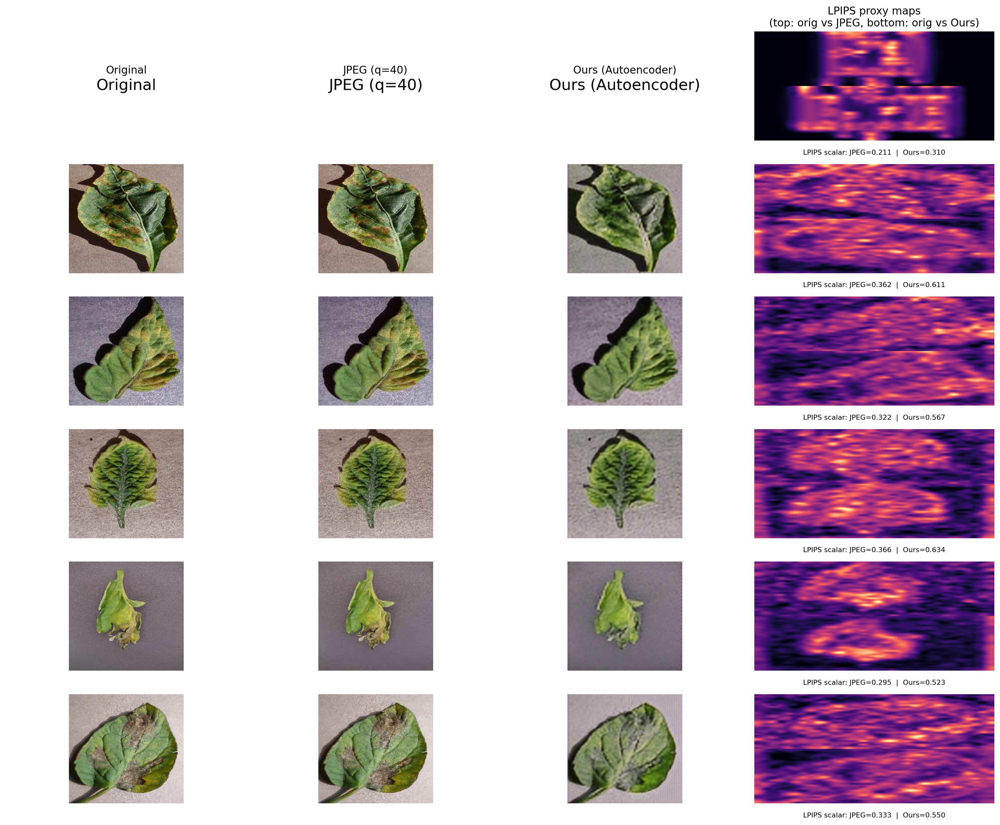

In [ ]:
# make_fig11_lpips_fixed.py
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import torch
import lpips
import torchvision.transforms as T
import torchvision.models as models
import cv2

# --------- USER SETTINGS ----------
COMPOSITE_PATH = "/content/drive/MyDrive/plant_leaf_compression/final_model/qualitative_comparison_leafs.png"
OUT_DIR = "/mnt/data"
OUT_FIG = os.path.join(OUT_DIR, "fig11_lpips.png")
VERIF = os.path.join(OUT_DIR, "fig11_verification_grid.png")

expected_cols = 4   # set to 3 or 4 if auto-detect falters
white_threshold = 245
resize_h = 256      # height for LPIPS/VGG features (keeps compute reasonable)
max_rows_plot = 6   # number of rows (samples) to include in the final figure (pick representative)
feat_layer_idx = 16 # VGG layer index to use for proxy spatial maps (conv4_3 ~ 16)
# ----------------------------------

os.makedirs(OUT_DIR, exist_ok=True)

# ---- helpers ----
def detect_segments(proj, min_width=20):
    segs = []
    in_seg = False
    start = 0
    for i,v in enumerate(proj):
        if v and not in_seg:
            in_seg = True; start = i
        elif (not v) and in_seg:
            end = i; in_seg = False
            if end - start >= min_width:
                segs.append((start,end))
    if in_seg:
        end = len(proj)
        if end - start >= min_width:
            segs.append((start,end))
    return segs

def normalize_0_1(x):
    x = x - x.min()
    mx = x.max()
    if mx > 0:
        x = x / mx
    return x

# ---- load composite and detect grid ----
img = Image.open(COMPOSITE_PATH).convert("RGB")
img_np = np.array(img)
H, W = img_np.shape[:2]

mask = np.any(img_np < white_threshold, axis=2).astype(np.uint8)
col_proj = mask.sum(axis=0) > 0
row_proj = mask.sum(axis=1) > 0
col_segs = detect_segments(col_proj)
row_segs = detect_segments(row_proj)

# fallbacks
if len(col_segs) <= 1:
    n = expected_cols or 4
    col_segs = [(int(i*W/n), int((i+1)*W/n)) for i in range(n)]
if len(row_segs) == 0:
    nrows_guess = max(1, H // 200)
    row_segs = [(int(i*H/nrows_guess), int((i+1)*H/nrows_guess)) for i in range(nrows_guess)]

ncols = len(col_segs)
nrows = len(row_segs)
print("Detected grid:", nrows, "rows x", ncols, "cols")

# assume columns: Original=0, JPEG=1, Ours=2 (adjust if needed)
orig_idx = 0
jpeg_idx = 1 if ncols >= 2 else 0
ours_idx = 2 if ncols >= 3 else 1

if orig_idx >= ncols or ours_idx >= ncols:
    raise RuntimeError("Column index out of range. Adjust orig_idx/ours_idx or expected_cols.")

# ---- extract triplets ----
orig_list, jpeg_list, ours_list = [], [], []
for r0, r1 in row_segs:
    hseg = r1 - r0
    top = r0 + int(0.03*hseg)
    bottom = r1 - int(0.02*hseg)
    if bottom <= top:
        top = r0; bottom = r1
    o0,o1 = col_segs[orig_idx]
    j0,j1 = col_segs[jpeg_idx]
    u0,u1 = col_segs[ours_idx]
    orig = img_np[top:bottom, o0:o1].copy()
    jpeg = img_np[top:bottom, j0:j1].copy()
    ours = img_np[top:bottom, u0:u1].copy()
    if orig.size == 0 or ours.size == 0:
        continue
    mh = min(orig.shape[0], jpeg.shape[0], ours.shape[0])
    mw = min(orig.shape[1], jpeg.shape[1], ours.shape[1])
    orig = orig[:mh, :mw]; jpeg = jpeg[:mh, :mw]; ours = ours[:mh, :mw]
    orig_list.append(orig); jpeg_list.append(jpeg); ours_list.append(ours)

print("Extracted", len(orig_list), "samples")
if len(orig_list) == 0:
    raise RuntimeError("No rows extracted. Check composite layout or thresholds.")

# choose indices to plot
indices = list(range(len(orig_list)))
if len(indices) > max_rows_plot:
    indices = np.linspace(0, len(indices)-1, max_rows_plot).astype(int).tolist()

# ---- set up models ----
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
lpips_model = lpips.LPIPS(net='vgg').to(device)
lpips_model.eval()

vgg = models.vgg16(pretrained=True).features.to(device).eval()

# transforms
to_tensor_vgg = T.Compose([
    T.ToTensor(),
    T.Resize((resize_h, resize_h)),
    T.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225])
])

def img_to_tensor_lpips(arr):
    t = torch.from_numpy(arr.transpose(2,0,1)).unsqueeze(0).float() / 255.0
    t = (t - 0.5) * 2.0
    return t.to(device)

def img_to_vgg_tensor(arr):
    im = Image.fromarray(arr.astype(np.uint8)).convert('RGB')
    t = to_tensor_vgg(im).unsqueeze(0).to(device)
    return t

# ---- compute LPIPS scalars + proxy spatial maps (VGG-feature L2) ----
lpips_scalars = []
spatial_maps = []  # list of tuples (map_j_up, map_o_up)
for idx in indices:
    orig = orig_list[idx]; jpeg = jpeg_list[idx]; ours = ours_list[idx]

    # LPIPS scalar
    t_orig = img_to_tensor_lpips(orig)
    t_jpeg = img_to_tensor_lpips(jpeg)
    t_ours  = img_to_tensor_lpips(ours)
    with torch.no_grad():
        s_j = lpips_model.forward(t_orig, t_jpeg).item()
        s_o = lpips_model.forward(t_orig, t_ours).item()
    lpips_scalars.append((s_j, s_o))

    # VGG feature maps (proxy spatial map)
    tv_orig = img_to_vgg_tensor(orig)
    tv_jpeg = img_to_vgg_tensor(jpeg)
    tv_ours  = img_to_vgg_tensor(ours)

    # extract features up to feat_layer_idx
    def extract_feat(tensor):
        x = tensor
        for i,layer in enumerate(vgg):
            x = layer(x)
            if i == feat_layer_idx:
                return x  # [1, C, Hf, Wf]
        return x

    with torch.no_grad():
        feat_orig = extract_feat(tv_orig)
        feat_jpeg = extract_feat(tv_jpeg)
        feat_ours  = extract_feat(tv_ours)

        # compute L2 over channels -> 2D map [Hf, Wf]
        def feat_map_l2(fa, fb):
            # fa, fb shapes [1,C,Hf,Wf]
            diff2 = (fa - fb).pow(2)           # [1,C,Hf,Wf]
            summed = diff2.sum(dim=1)         # [1,Hf,Wf]
            l2 = torch.sqrt(summed + 1e-12)   # [1,Hf,Wf]
            arr = l2.squeeze(0).cpu().numpy() # [Hf,Wf]
            return arr

        map_j = feat_map_l2(feat_orig, feat_jpeg)
        map_o = feat_map_l2(feat_orig, feat_ours)

        # normalize and upsample to display size (resize_h x resize_h)
        map_jn = normalize_0_1(map_j).astype('float32')
        map_on = normalize_0_1(map_o).astype('float32')
        map_j_up = cv2.resize(map_jn, (resize_h, resize_h), interpolation=cv2.INTER_CUBIC)
        map_o_up = cv2.resize(map_on, (resize_h, resize_h), interpolation=cv2.INTER_CUBIC)

        spatial_maps.append((map_j_up, map_o_up))

# ---- Compose Figure 11 (LPIPS) ----
n = len(indices)
cols = 4  # Original | JPEG | Ours | LPIPS stacked (top: orig vs jpeg, bottom: orig vs ours)
fig_w = 4.0 * cols
fig_h = 2.2 * n
plt.figure(figsize=(fig_w, fig_h), dpi=200)

for r, idx in enumerate(indices):
    orig = orig_list[idx]; jpeg = jpeg_list[idx]; ours = ours_list[idx]
    # uniform display height
    disp_h = resize_h
    def resize_for_display(arr):
        im = Image.fromarray(arr.astype(np.uint8))
        w = int(im.width * (disp_h / im.height))
        return np.array(im.resize((w, disp_h), Image.LANCZOS))
    disp_orig = resize_for_display(orig)
    disp_jpeg = resize_for_display(jpeg)
    disp_ours = resize_for_display(ours)

    plt.subplot(n, cols, r*cols + 1); plt.imshow(disp_orig); plt.axis('off')
    if r==0: plt.title("Original")
    plt.subplot(n, cols, r*cols + 2); plt.imshow(disp_jpeg); plt.axis('off')
    if r==0: plt.title("JPEG (q=40)")
    plt.subplot(n, cols, r*cols + 3); plt.imshow(disp_ours); plt.axis('off')
    if r==0: plt.title("Ours (Autoencoder)")

    map_j_up, map_o_up = spatial_maps[r]
    combined = np.vstack([map_j_up, map_o_up])  # shape (2*resize_h, resize_h)
    plt.subplot(n, cols, r*cols + 4)
    plt.imshow(combined, cmap='magma', aspect='auto')
    plt.axis('off')
    sj, so = lpips_scalars[r]
    if r==0:
        plt.title("LPIPS proxy maps\n(top: orig vs JPEG, bottom: orig vs Ours)")
    plt.text(0.5, -0.08, f"LPIPS scalar: JPEG={sj:.3f}  |  Ours={so:.3f}",
             transform=plt.gca().transAxes, ha='center', va='top', fontsize=8)

plt.tight_layout()
plt.savefig(OUT_FIG, dpi=300, bbox_inches='tight')
print("Saved LPIPS figure to:", OUT_FIG)

# ---- verification grid (Original|JPEG|Ours) ----
thumb_h = 220
from PIL import Image as PILImage
thumbs=[]
for idx in indices:
    o=orig_list[idx]; j=jpeg_list[idx]; u=ours_list[idx]
    o_p=PILImage.fromarray(o); j_p=PILImage.fromarray(j); u_p=PILImage.fromarray(u)
    def resize_keep_h(im, target_h):
        w0,h0 = im.size
        new_w = int(w0*(target_h/h0))
        return im.resize((new_w,target_h))
    thumbs += [resize_keep_h(o_p,thumb_h), resize_keep_h(j_p,thumb_h), resize_keep_h(u_p,thumb_h)]
rows = len(indices)
row_w = max(sum(thumbs[r*3 + c].size[0] for c in range(3)) for r in range(rows))
grid = PILImage.new("RGB", (row_w, rows*thumb_h), (255,255,255))
y=0
for r in range(rows):
    x=0
    for c in range(3):
        grid.paste(thumbs[r*3 + c], (x,y))
        x += thumbs[r*3 + c].size[0]
    y += thumb_h
grid.save(VERIF)
print("Saved verification grid to:", VERIF)
